## Moisture transport for TPV case July 2008 - comparison WRF, ERA5 and GPM

In [2]:
import numpy as np 
import xarray as xr 
import glob 
import matplotlib.pyplot as plt 
import matplotlib.colors as colors
import cartopy.crs as ccrs
import quiver 
import pandas as pd 
import shapely.geometry as sgeom
import seaborn as sns 
from obspy.imaging.cm import obspy_divergent, viridis_white_r

In [448]:
#### ERA5 AWT files ####
era_file_list = glob.glob('tpv_2008_awt/reanalysis*200807??_??*tp*.nc')
era_file_list.sort()

#### WRF AWT files ####
file_list = glob.glob('tpv_2008_awt/wrfout*2008-07-??_??*6hours*.nc')
file_list.sort()


#### Files for precipitation ####
gpm_files = glob.glob('tpv_2008_awt/gpm*6hour*')
era_files = glob.glob('tpv_2008_awt/ERA5*precip*6hour*')
wrf_files = glob.glob('tpv_2008_awt/wrf_precip_2008*')
wrf4km_files = glob.glob('../data/model/CPTP/r1i1p1/*6hours*nc')
gpm_files.sort()
wrf_files.sort()
wrf4km_files.sort()
era_files.sort()

### TPV track database ###
file = '../mcs_tracking/TPV/tr_trs_VOR500_pos_tp3000_addfld_precip_filt_Z500_1ts_moving_off_box_main_genesis_region.tpv.real_time'
cols = ['time', 'lon', 'lat', 'vorticity', 'precip',  'lon_geo', 'lat_geo',  'geopm', 'id']


#import elevation for 3000 m contour of TP 
dem = '/media/juli/Data/projects/data/elevation/elevation_600x350.nc'
elevations = xr.open_dataarray(dem)
longitude = elevations.lon.values
latitude= elevations.lat.values
lo, la = np.meshgrid(longitude, latitude)

In [4]:
### select case ### 
tpv =  pd.DataFrame(columns=cols)

with open(file, 'r') as td:
    for line in td:
        if 'TRACK_ID' in line:
            for i in line.split():
                if len(i) == 4:
                    trackid= int(i) 
            
        if len(line) > 50:
            columns = []
            for i in line.split():
                if i != '&':
                    if '2008' in i:
                        columns.append(i)
                    else:
                        columns.append(float(i))
            columns.append(trackid)
            tpv.loc[len(tpv)]= columns
            
# get right data types for dataframe 
tpv['time']=pd.to_datetime(tpv['time'],format='%Y%m%d%H')
# group rows by track ID 
tracks= tpv.groupby(tpv.id)

In [5]:
# function to derive track coordinates for all tracks which pass through timestep 
# input parameter: timestep in datetime.datetime format 
# returns: dictionary which holds all track lons and lats per trackid , lon and lat values for timestep

def get_tracks_by_date(date):
    keys = []
    values= []
    lon_t = []
    lat_t= []
    times= []
    count = 0 
    for t in tpv.time:
        t= np.datetime64(t).astype(datetime.datetime)
        if t == date:
            print('getting info for', date)
            tid= np.unique(tpv.id[tpv.time== t])
            for tidx in tid:
                lo = tpv.lon[tpv.id == tidx].values
                la = tpv.lat[tpv.id == tidx].values
                lon_t.append(tpv.lon[tpv.id == tidx].values)
                lat_t.append(tpv.lat[tpv.id == tidx].values)
                keys.append(str(tidx))
                values.append([lo, la])
                count+=1
            times.append(tpv[tpv.id == tidx].time.values)
            
    if count > 0:          
        coords= dict(zip(keys, values))
    else:
        coords = 0 
        print('no tracks available.')
        
    return coords, lon_t, lat_t, times 


In [6]:
# select case for July 2008 
import datetime
date = datetime.datetime(2008,7,19, 18, 0)
coords, lon_t, lat_t, times = get_tracks_by_date(date)
times.sort()


getting info for 2008-07-19 18:00:00


In [128]:
def plot_awt(file, times, time_idx):
    # open dataset 
    dataset = xr.open_dataset(file, decode_times=False)
    awt_u= dataset['p71.162'][0]
    awt_v= dataset['p72.162'][0]
    # import coordinates
    lon = dataset.longitude.values
    lat = dataset.latitude.values
    lons,lats= np.meshgrid(lon,lat)
    # calculate the absolute flux by adding u and v components
    q_clim = np.abs(awt_u) + np.abs(awt_v)
    dataset.close()
    
    fig =plt.figure(figsize=(12,12))
    
    # labels, fontsize, color 
    xlabels=[50,60,70,80,90,100,110,120]
    ylabels= [10,20,30,40,50]
    fs= 22
    c= 'k'
    # customizing of colorbar 
    cmap=plt.cm.viridis
    r = np.arange(0,600,50)
    norm = colors.BoundaryNorm(boundaries= r,  ncolors= 256)

    # spacing of wind vectors 

    # convert coords to 2d array 
    x,y  = lons,lats
    skip  =(slice(None,None,8),slice(None,None,8))

    # Plot ERA5 moisture transport in map 
    ax = plt.subplot(1, 1, 1, projection=ccrs.PlateCarree())
    ax.set_extent([50,130,10,50])
    timestr = times[0][time_idx]
    ax.set_title(str(timestr), fontsize= 28 )
    ax.coastlines(linewidth = 1.5)
    ax.contour(elevations.lon.values,elevations.lat.values, elevations.data.T, [3000], cmap = 'Greys_r')

    # Plot wind vectors 
    x,y = lons,lats
    m= ax.pcolormesh(lons, lats, q_clim,norm = norm, cmap = cmap  )    
    ax.quiver(x[skip],y[skip],awt_u[skip], awt_v[skip], color =c, transform= ccrs.PlateCarree()) 

    # axis labels 
    ax.set_xticks(xlabels, xlabels)
    ax.set_yticks(ylabels,ylabels)
    ax.set_ylabel('Lat $^\circ$N',  fontsize=fs)
    ax.set_xlabel('Lon $^\circ$E',  fontsize=fs)
    
    
    # TPV track 
    for key in coords.keys():
        track_lons = coords[key][0]
        track_lats =  coords[key][1]
        track = sgeom.LineString(zip(track_lons, track_lats))
        ax.add_geometries([track], ccrs.PlateCarree(),facecolor='none', edgecolor='black', linewidth= 5.0)


    # plot vorticity center of timestep 
    ax.plot(lon_t[0][0], lat_t[0][0],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')

    ax.plot(lon_t[0][time_idx], lat_t[0][time_idx],transform=ccrs.PlateCarree(), color='white', markersize=25,marker= 'o')

    ax.plot(lon_t[0][-1], lat_t[0][-1],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')



    plt.rcParams.update({'font.size': fs})
    plt.colorbar(m, extend = 'max', label = 'IVT kg m$^{-1}$ s$^{-1}$', orientation = 'horizontal')

    plt.savefig('tpv_2008_awt/tpv_'+ str(timestr)+'.png')
    plt.show()

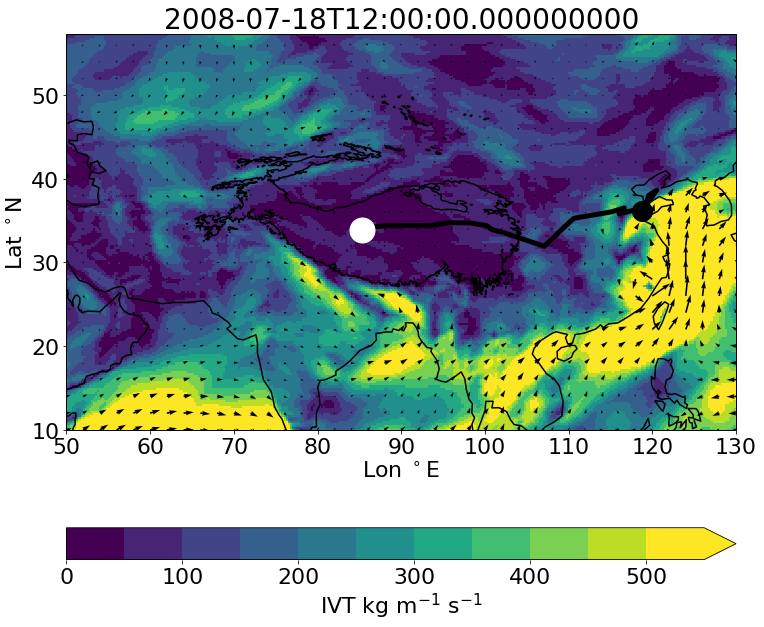

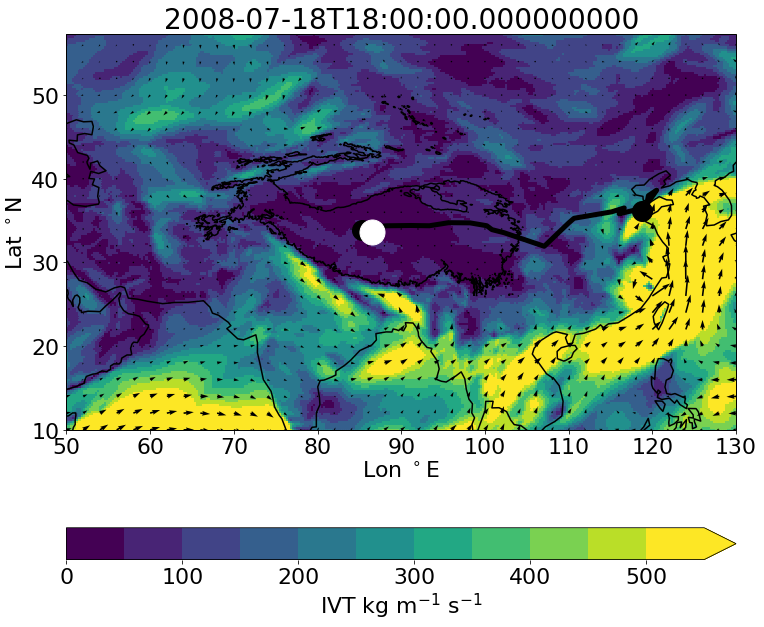

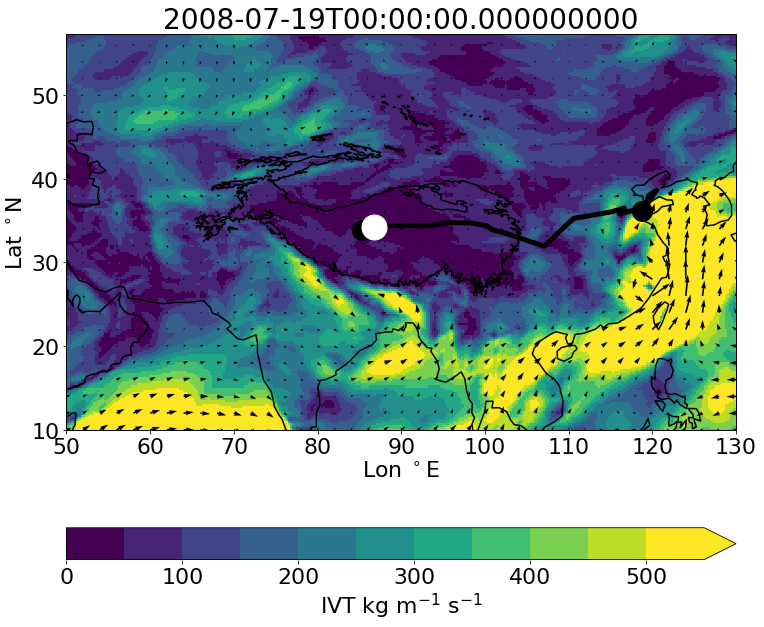

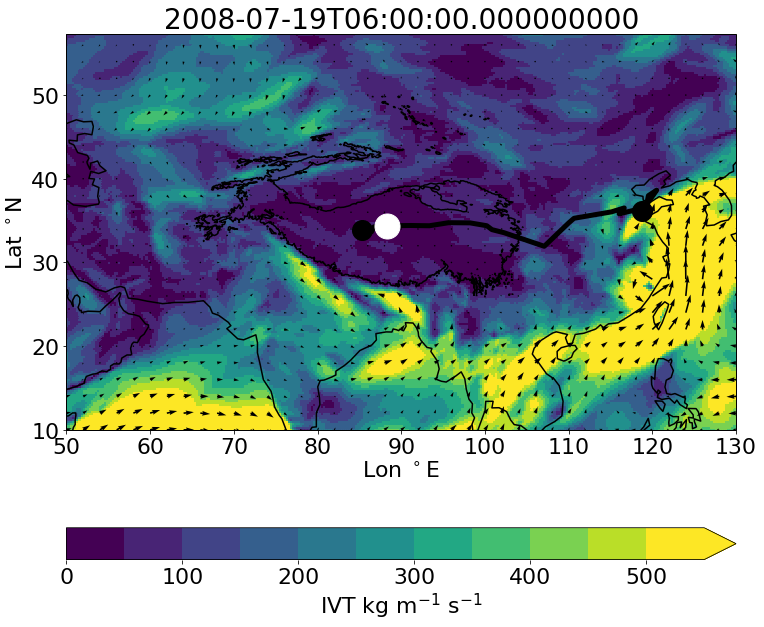

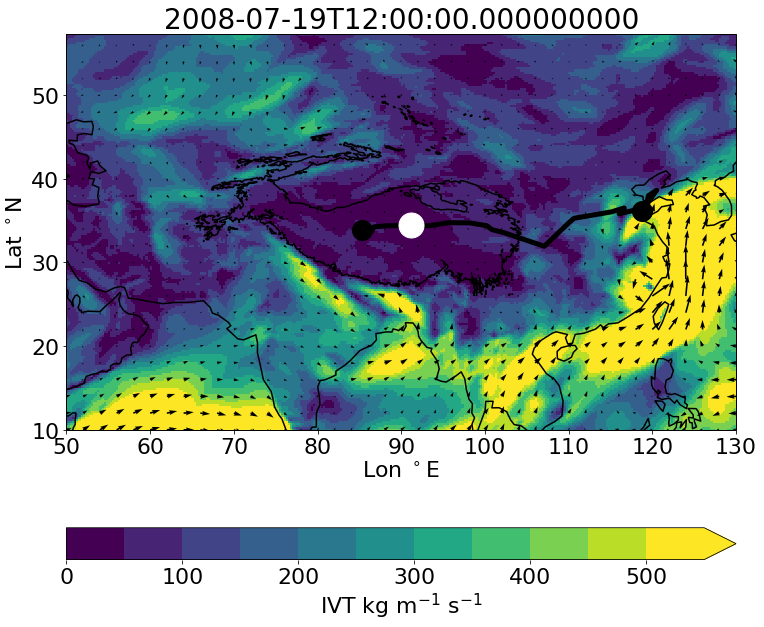

...

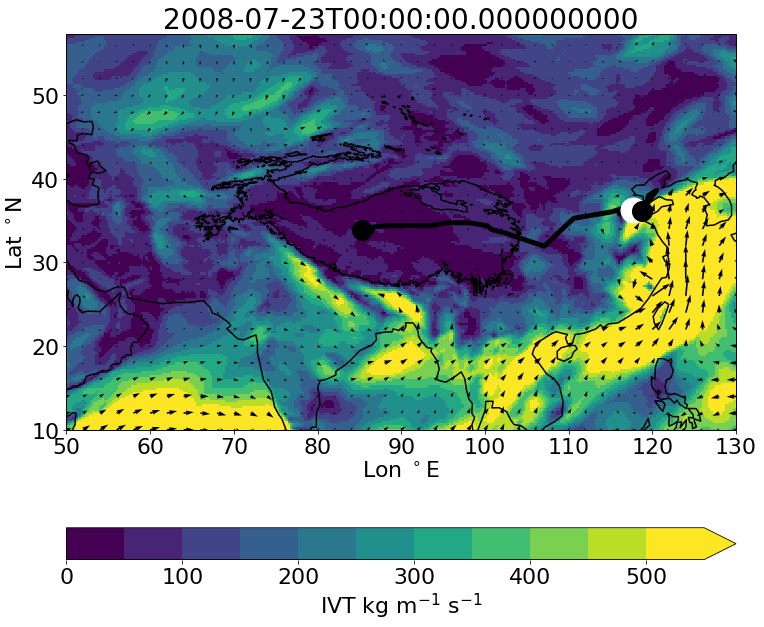

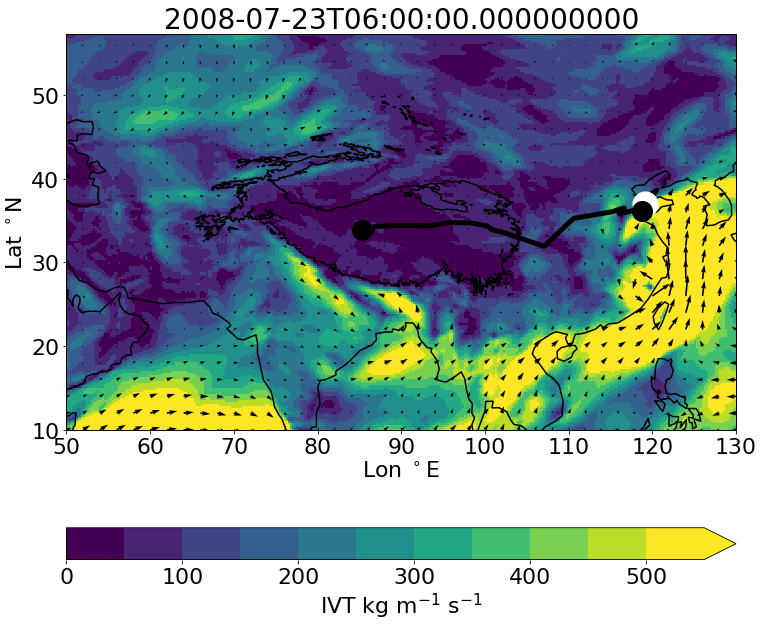

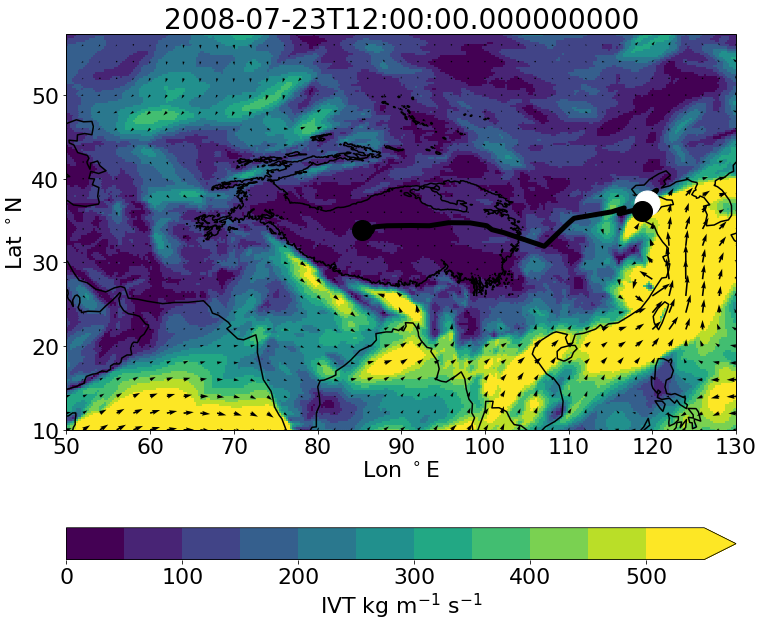

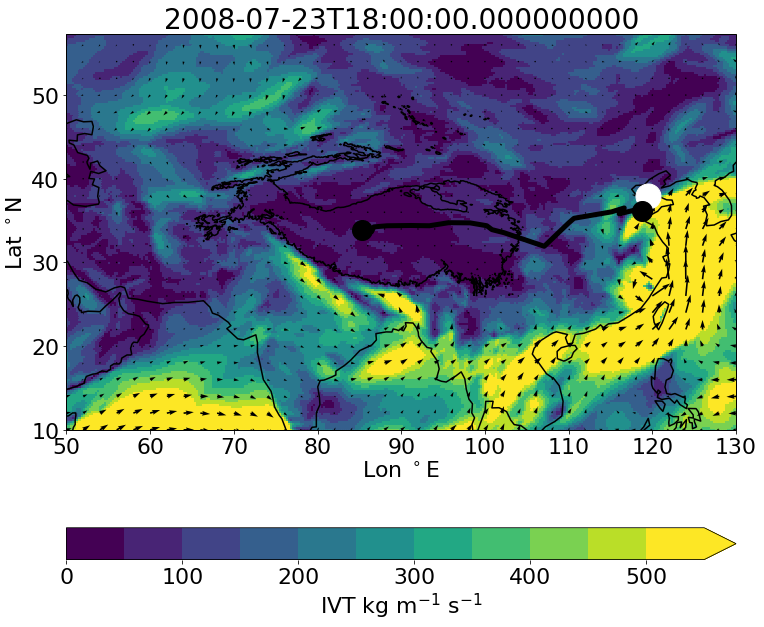

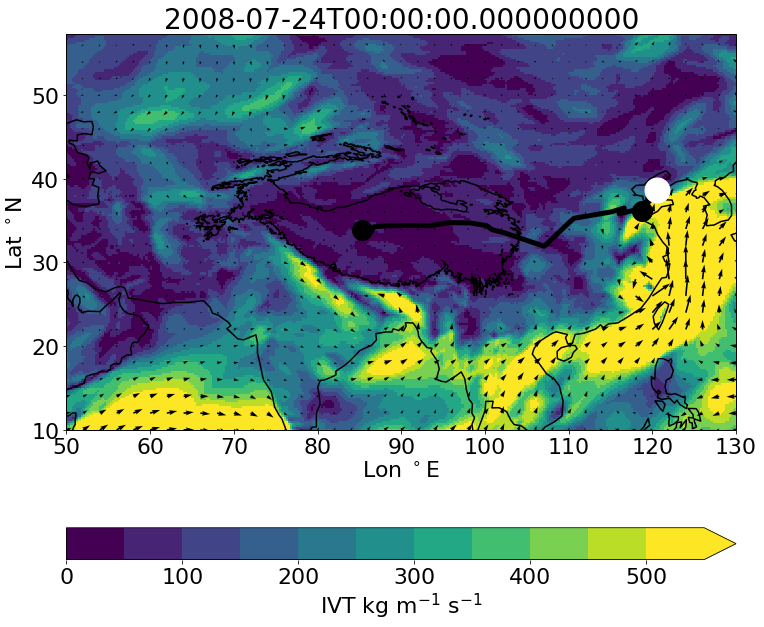

In [131]:
for time_idx in np.arange(len(file_list)):
    plot_awt(file_list[time_idx], times, time_idx)

## Plot AWT, stream lines and inflow to TP 

In [1009]:
def plot_awt_stream(file, times, time_idx):
    # open dataset 
    dataset = xr.open_dataset(file, decode_times=False)
    awt_u= dataset['p71.162'][0].values
    awt_v= dataset['p72.162'][0].values
    # import coordinates
    lon = dataset.longitude.values
    lat = dataset.latitude.values
    lons,lats= np.meshgrid(lon,lat)
    # calculate the absolute flux by adding u and v components
    q_clim = np.abs(awt_u) + np.abs(awt_v)
    dataset.close()
    
    fig =plt.figure(figsize=(12,12))
    
    # labels, fontsize, color 
    xlabels=[60,70,80,90,100,110]
    ylabels= [25,30,35,40,45]
    fs= 22
    c= 'k'
    # customizing of colorbar 
    cmap=plt.cm.Blues
    r = np.arange(0,650,50)
    norm = colors.BoundaryNorm(boundaries= r,  ncolors= 256)
    r2 = np.arange(-50,55,5)
    norm2 = colors.BoundaryNorm(boundaries= r2,  ncolors= 256)


    # spacing of wind vectors 

    # convert coords to 2d array 
    x,y  = lons,lats
    skip  =(slice(None,None,4),slice(None,None,4))

    # Plot ERA5 moisture transport in map 
    ax = plt.subplot(1, 1, 1, projection=ccrs.PlateCarree())
    ax.set_extent([60,120,22,35])
    ax.set_extent([60,120,14,45])
    timestr = times[0][time_idx]
    ax.set_title(str(timestr), fontsize= 28 )
    ax.coastlines(linewidth = 1.5)
    #ax.contour(elevations.lon.values,elevations.lat.values, elevations.data.T, [3000], cmap = 'Greys_r')

    # Plot wind vectors 
    x,y = lons,lats
    m= ax.pcolormesh(lons, lats, q_clim,norm = norm, cmap = cmap)
    
    #ax.quiver(lons[skip], lats[skip], awt_u[skip], awt_v[skip], color = c, transform= ccrs.PlateCarree()) 
    
    ax.streamplot(lons, lats, awt_u, awt_v, color = 'grey', transform= ccrs.PlateCarree()) 
    
    # calculate water transport uphill towards the TP (excluding along and downhill transport)
    dotproduct = get_awt_tpwards_tp(awt_u, awt_v, lats, lons)
    tp = ax.scatter(lo,la,c = dotproduct, s= 40 , cmap = 'coolwarm_r', norm=norm2,  vmin=-50,vmax=50)
    #plt.rcParams.update({'font.size': fs})
    plt.colorbar(tp, extend = 'both', label = 'TP IVT kg m$^{-1}$ s$^{-1}$', orientation = 'horizontal')


    # axis labels 
    ax.set_xticks(xlabels, xlabels)
    ax.set_yticks(ylabels,ylabels)
    ax.set_ylabel('Lat $^\circ$N',  fontsize=fs)
    ax.set_xlabel('Lon $^\circ$E',  fontsize=fs)
    
    
    # TPV track 
    for key in coords.keys():
        track_lons = coords[key][0]
        track_lats =  coords[key][1]
        track = sgeom.LineString(zip(track_lons, track_lats))
        ax.add_geometries([track], ccrs.PlateCarree(),facecolor='none', edgecolor='black', linewidth= 5.0)


    # plot vorticity center of timestep 
    ax.plot(lon_t[0][0], lat_t[0][0],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')

    ax.plot(lon_t[0][time_idx], lat_t[0][time_idx],transform=ccrs.PlateCarree(), color='crimson', markersize=25,marker= 'o')

    ax.plot(lon_t[0][-1], lat_t[0][-1],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')

    plt.rcParams.update({'font.size': fs})
    plt.colorbar(m, extend = 'max', label = 'IVT kg m$^{-1}$ s$^{-1}$', orientation = 'horizontal')

    plt.savefig('tpv_2008_awt/tpv_'+ str(timestr)+'_stream.png')
    plt.show()

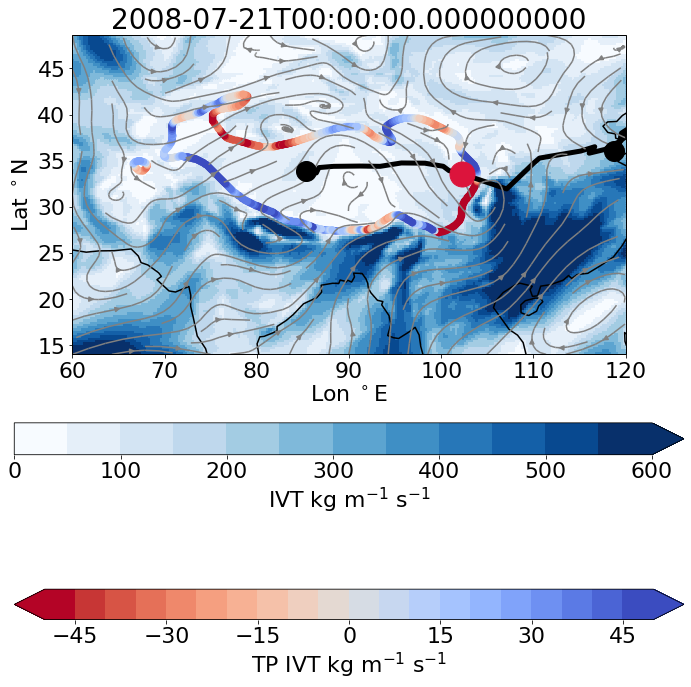

In [1021]:
time_idx= 10
plot_awt_stream(file_list[time_idx], times, time_idx)

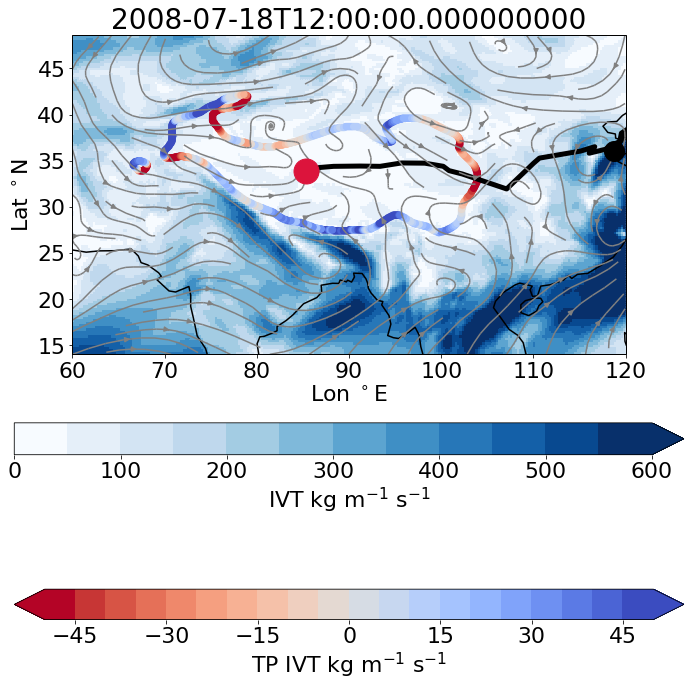

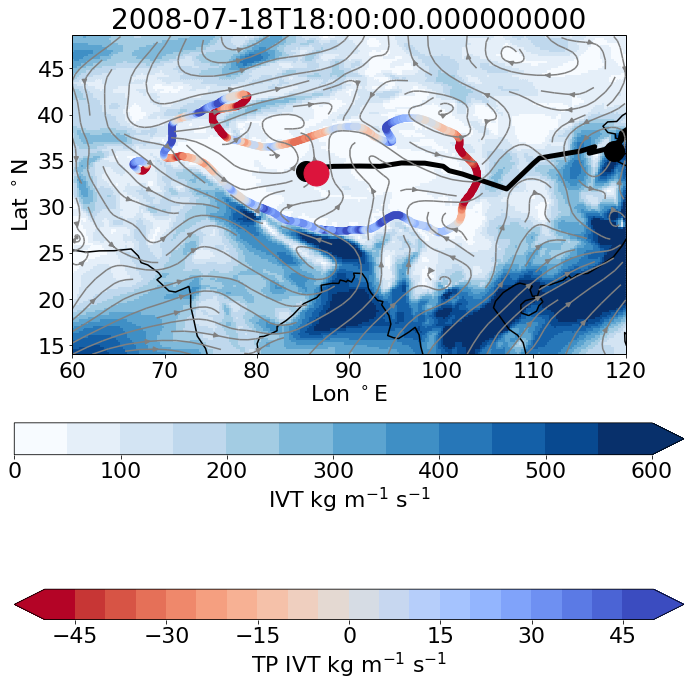

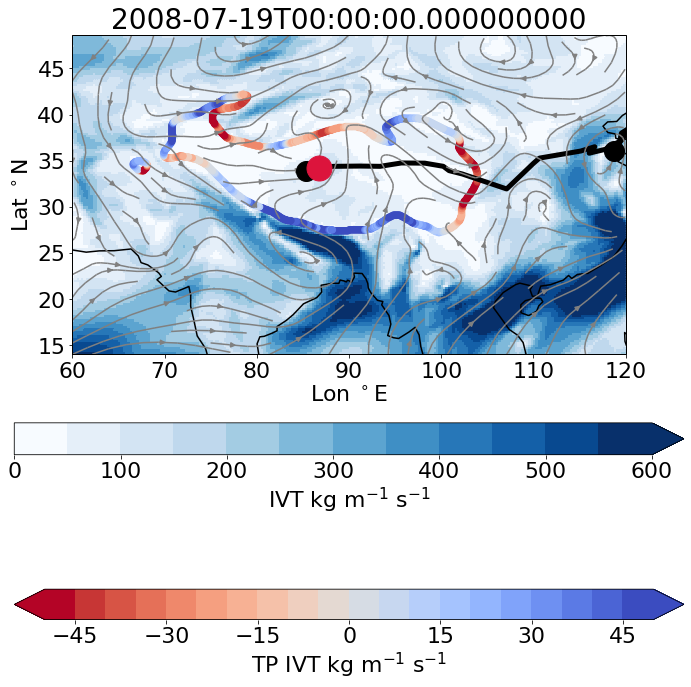

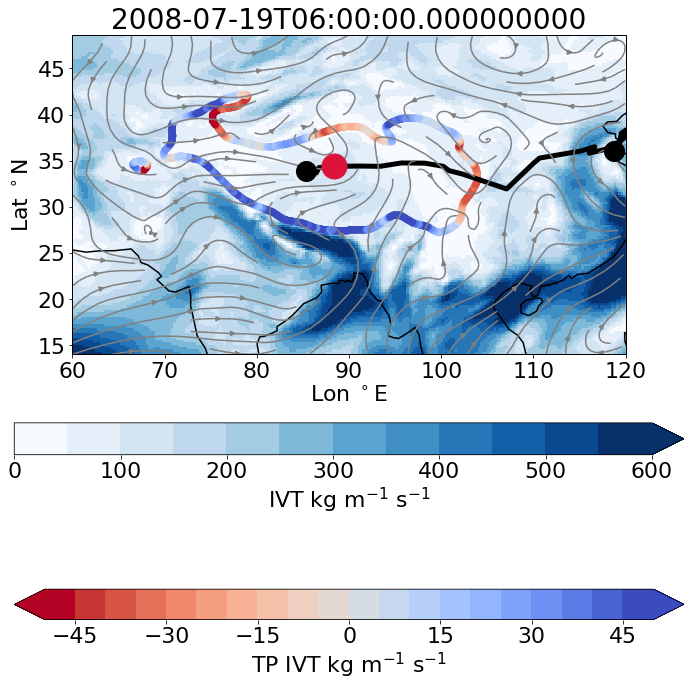

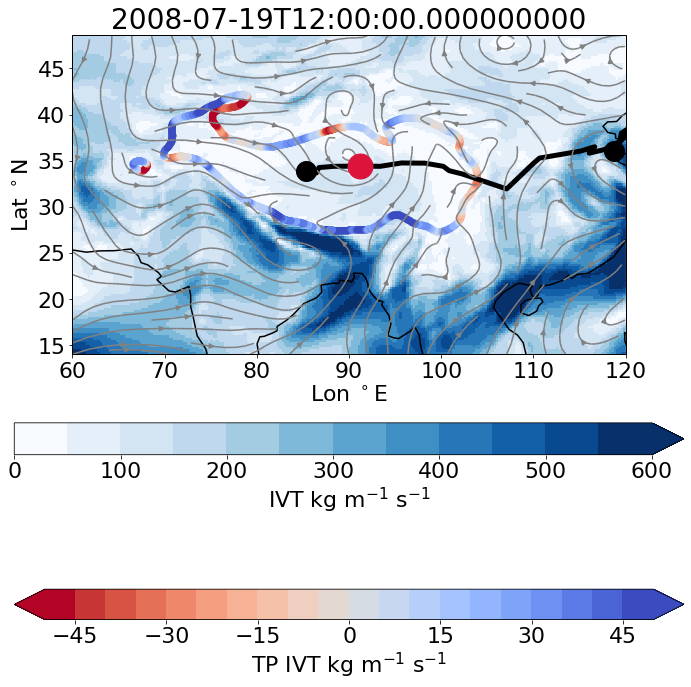

...

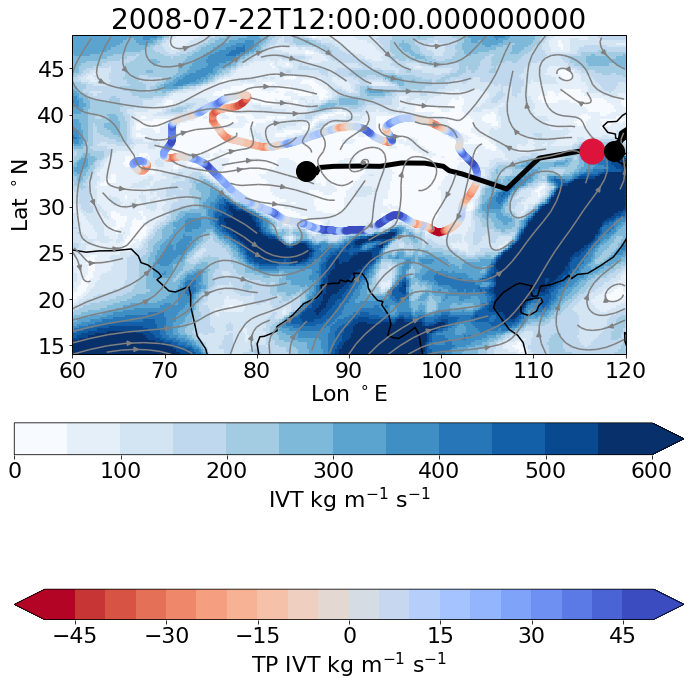

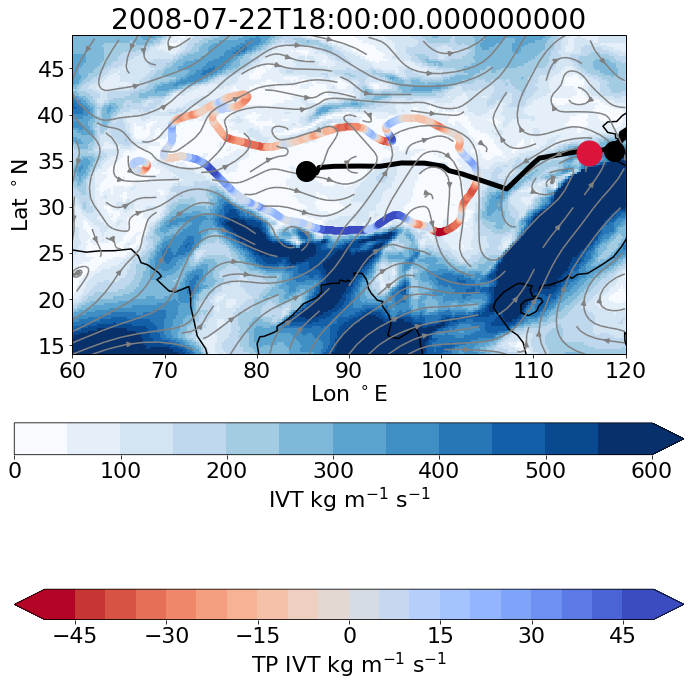

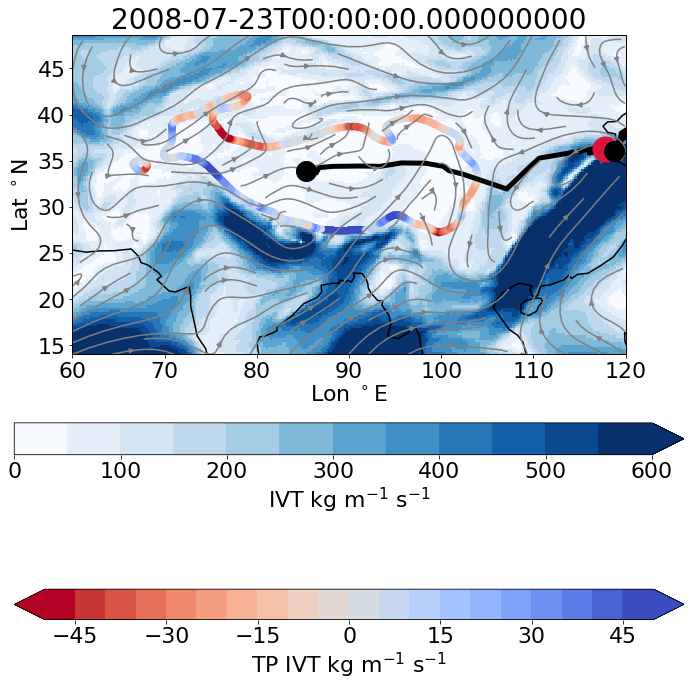

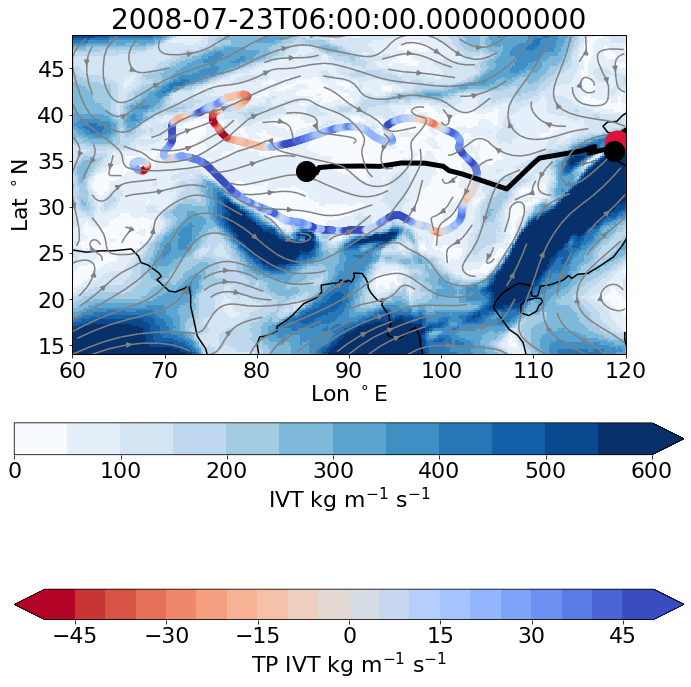

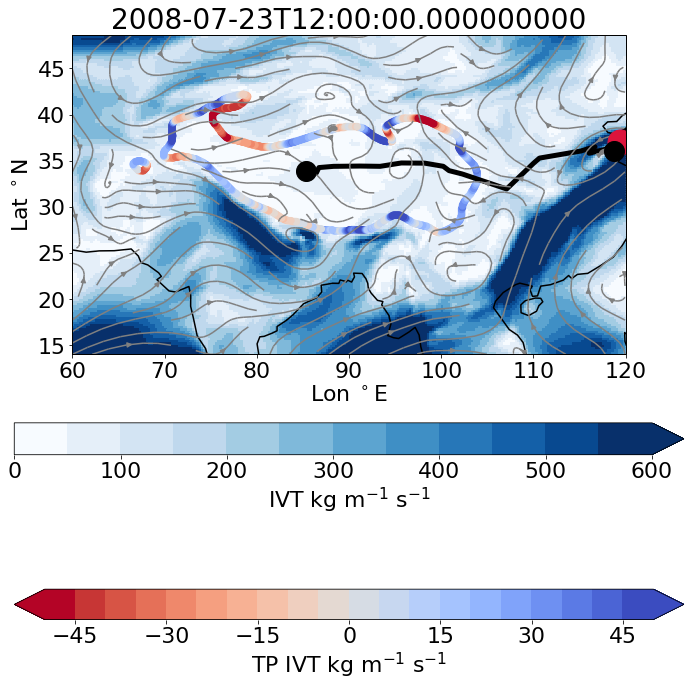

In [ ]:
for time_idx in np.arange(len(file_list)):
    plot_awt_stream(file_list[time_idx], times, time_idx)

## Plot anomaly of water transport towards plateau 

In [314]:
# open dataset 
dataset = xr.open_dataset('tpv_2008_awt/july_clim_2008.nc', decode_times=False)
clim_u= dataset['p71.162'][0]
clim_v= dataset['p72.162'][0]

In [323]:
def plot_awt_clim(file, times, time_idx, clim_u, clim_v):
    # open dataset 
    dataset = xr.open_dataset(file, decode_times=False)
    awt_u= dataset['p71.162'][0]
    awt_v= dataset['p72.162'][0]
    # import coordinates
    lon = dataset.longitude.values
    lat = dataset.latitude.values
    lons,lats= np.meshgrid(lon,lat)
    # calculate the absolute flux by adding u and v components
    qtotal = np.abs(awt_u) + np.abs(awt_v)
    qclim = np.abs(clim_u) + np.abs(clim_v)
    dataset.close()
    awt_u = clim_u - awt_u
    awt_v = clim_v - awt_v
    
    fig =plt.figure(figsize=(12,12))
    
    # labels, fontsize, color 
    xlabels=[60,70,80,90,100,110]
    ylabels= [25,30,35,40,45]
    fs= 22
    c= 'k'
    # customizing of colorbar 
    cmap=plt.cm.Blues
    r = np.arange(0,50,2)
    norm = colors.BoundaryNorm(boundaries= r,  ncolors= 256)

    # spacing of wind vectors 

    # convert coords to 2d array 
    x,y  = lons,lats
    skip  =(slice(None,None,4),slice(None,None,4))

    # Plot ERA5 moisture transport in map 
    ax = plt.subplot(1, 1, 1, projection=ccrs.PlateCarree())
    ax.set_extent([60,120,22,35])
    timestr = times[0][time_idx]
    ax.set_title(str(timestr), fontsize= 28 )
    ax.coastlines(linewidth = 1.5)
    ax.contour(elevations.lon.values,elevations.lat.values, elevations.data.T, [3000], cmap = 'Greys_r')

    # Plot wind vectors 
    x,y = lons,lats
    m= ax.pcolormesh(lons, lats, qclim - qtotal,norm = norm, cmap = cmap  )    
    ax.quiver(x[skip],y[skip],awt_u[skip], awt_v[skip], color =c, pivot = 'middle', transform= ccrs.PlateCarree()) 

    # axis labels 
    ax.set_xticks(xlabels, xlabels)
    ax.set_yticks(ylabels,ylabels)
    ax.set_ylabel('Lat $^\circ$N',  fontsize=fs)
    ax.set_xlabel('Lon $^\circ$E',  fontsize=fs)
    
    
    # TPV track 
    for key in coords.keys():
        track_lons = coords[key][0]
        track_lats =  coords[key][1]
        track = sgeom.LineString(zip(track_lons, track_lats))
        ax.add_geometries([track], ccrs.PlateCarree(),facecolor='none', edgecolor='black', linewidth= 5.0)


    # plot vorticity center of timestep 
    ax.plot(lon_t[0][0], lat_t[0][0],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')

    ax.plot(lon_t[0][time_idx], lat_t[0][time_idx],transform=ccrs.PlateCarree(), color='darkorange', markersize=25,marker= 'o')

    ax.plot(lon_t[0][-1], lat_t[0][-1],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')

    plt.rcParams.update({'font.size': fs})
    plt.colorbar(m, extend = 'max', label = 'IVT kg m$^{-1}$ s$^{-1}$', orientation = 'horizontal')

    plt.savefig('tpv_2008_awt/tpv_'+ str(timestr)+'_clim.png')
    plt.show()

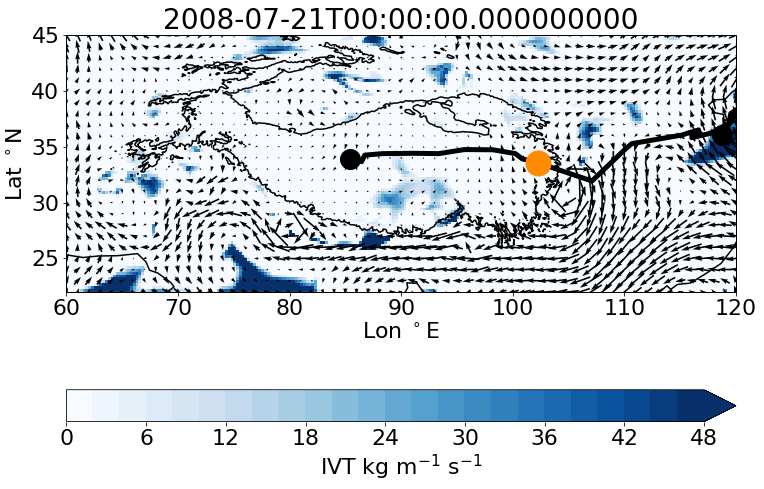

In [324]:
time_idx= 10
plot_awt_clim(file_list[time_idx], times, time_idx, clim_u, clim_v)

## Plot moisture transport for WRF 9km simulation 

In [9]:
R = 287.058
def colint_pressure(values,pressure_levels):
    return np.trapz(values, pressure_levels, axis = 0)* 9.8


dataset= 'tpv_2008_awt/wrfout_d01_2008-07-18_12_6hours.nc'
data= xr.open_dataset(dataset)

q = data.r_v_p[0] 
u = data.u_tr_p[0]
v = data.v_tr_p[0]
z = data.Z_p[0]
t = data.T_p[0].values
lons = data.lon.values
lats= data.lat.values 
pressure = data.pressure.values
data.close()

q=np.nan_to_num(q, 0)
z=np.nan_to_num(z, 0)
u=np.nan_to_num(u, 0)
v=np.nan_to_num(v, 0)

pressure_wrf = data.pressure.values
data.close()

# convert specific humidity to absolute humidity in kg/m3                                                                                          
for plev in np.arange(29):
    p_d = (pressure[plev] * 100)/(R*t[plev])
    q[plev] =q[plev]* p_d

    
q=np.nan_to_num(q, 0)
awt_u_wrf = colint_pressure(q*u, np.flip(pressure, 0) )
awt_v_wrf = colint_pressure(q*v, np.flip(pressure, 0) )
q_wrf = np.sqrt(awt_u_wrf**2 + awt_v_wrf**2 )

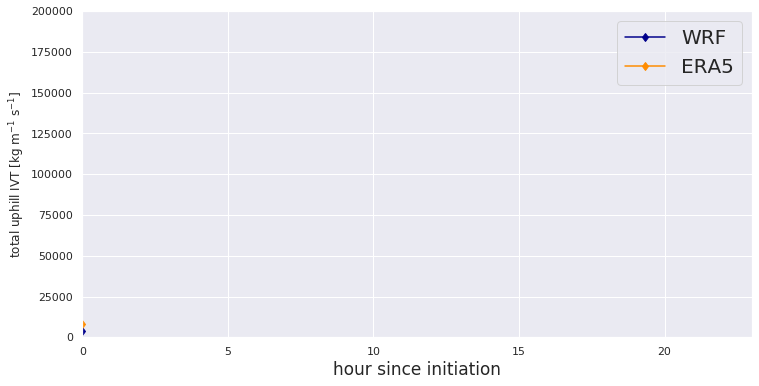

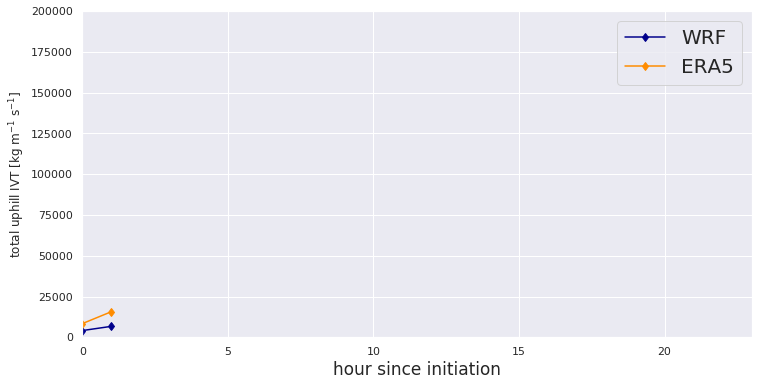

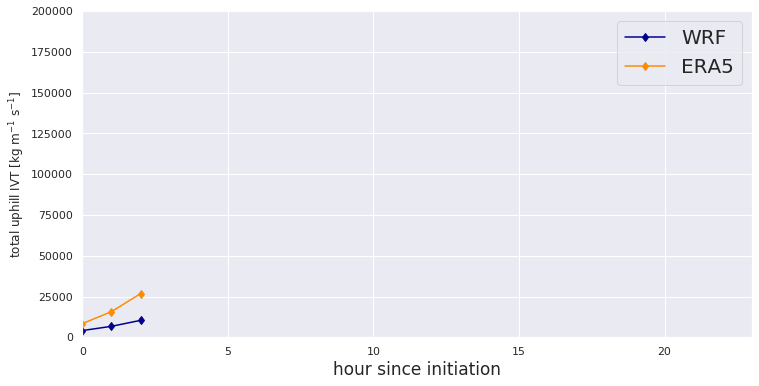

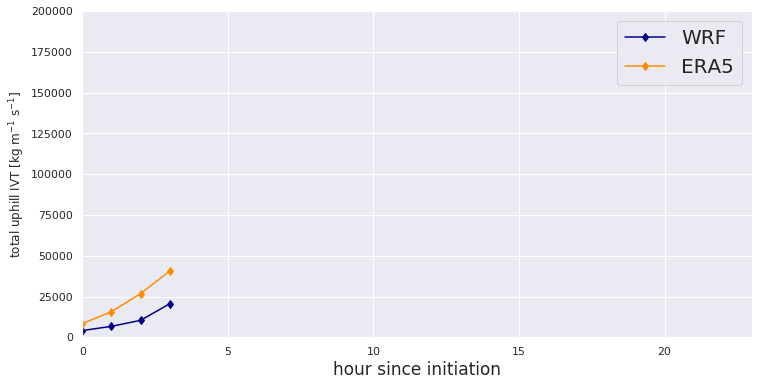

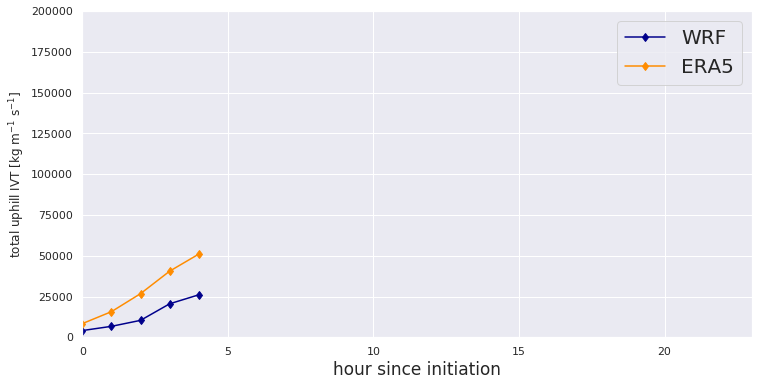

...

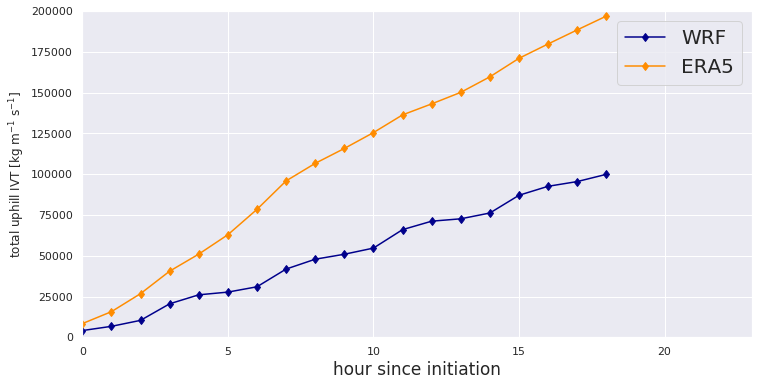

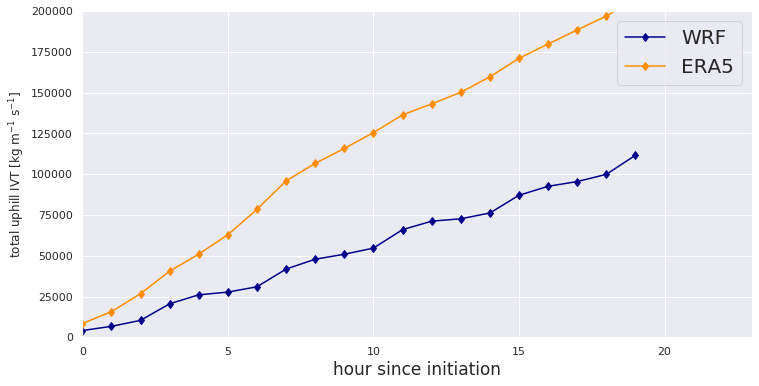

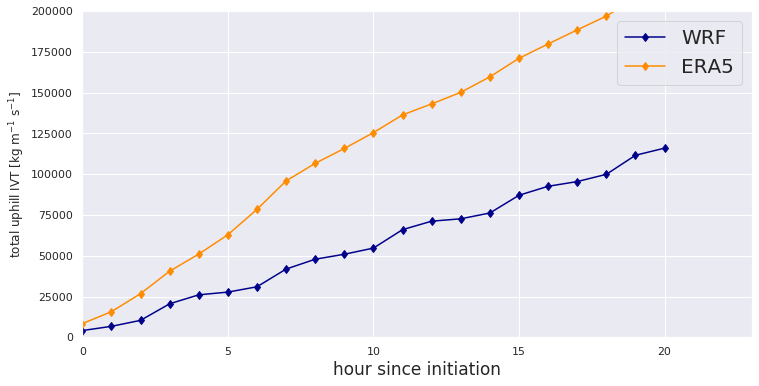

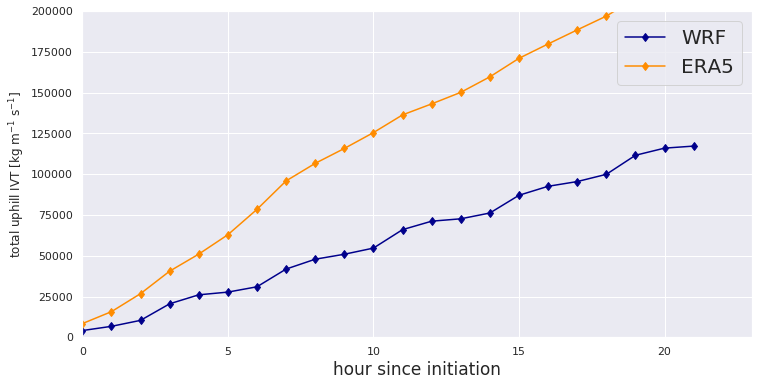

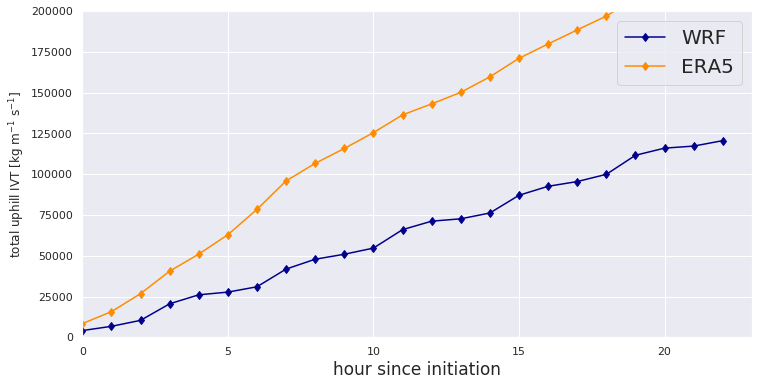

In [1087]:
inflow= np.zeros(len(file_list))
inflow[:] = np.nan

era_inflow= np.zeros(len(file_list))
era_inflow[:] = np.nan

for time_idx in np.arange(len(file_list)):
    #### get data ### 
    data= xr.open_dataset(file_list[time_idx])

    q = data.r_v_p[0] 
    u = data.u_tr_p[0]
    v = data.v_tr_p[0]
    z = data.Z_p[0]
    t = data.T_p[0].values
    lons = data.lon.values
    lats= data.lat.values 
    pressure = data.pressure.values
    data.close()

    q=np.nan_to_num(q, 0)
    z=np.nan_to_num(z, 0)
    u=np.nan_to_num(u, 0)
    v=np.nan_to_num(v, 0)

    pressure_wrf = data.pressure.values
    data.close()

    # convert specific humidity to absolute humidity in kg/m3                                                                                          
    for plev in np.arange(29):
        p_d = (pressure[plev] * 100)/(R*t[plev])
        q[plev] =q[plev]* p_d

    q=np.nan_to_num(q, 0)
    awt_u_wrf = colint_pressure(q*u, np.flip(pressure, 0) )
    awt_v_wrf = colint_pressure(q*v, np.flip(pressure, 0) )
    q_wrf = np.sqrt(awt_u_wrf**2 + awt_v_wrf**2 )
    
    dotproduct = get_awt_tpwards_tp(awt_u_wrf, awt_v_wrf, lats, lons)
    dotproduct[ newlat.T > 35]  = np.nan
    summa = np.nansum(dotproduct[dotproduct > 0 ])
    inflow[time_idx] = np.nansum([summa, inflow[time_idx - 1]]) 
    
    ### ERA5 ### 
    dataset = xr.open_dataset(era_file_list[time_idx], decode_times=False)
    awt_u= dataset['p71.162'][0].values
    awt_v= dataset['p72.162'][0].values
    # import coordinates
    lon = dataset.longitude.values
    lat = dataset.latitude.values
    lons,lats= np.meshgrid(lon,lat)
    # calculate the absolute flux by adding u and v components
    q_clim = np.abs(awt_u) + np.abs(awt_v)
    dataset.close()
    
    dotproduct = get_awt_tpwards_tp(awt_u, awt_v, lats, lons)
    dotproduct[ newlat.T > 35]  = np.nan
    summa = np.nansum(dotproduct[dotproduct > 0 ])
    era_inflow[time_idx] = np.nansum([summa, era_inflow[time_idx - 1]]) 
    
    ### plot ###
    plt.figure(figsize = (12,6))
    sns.set()
    plt.xlabel('hour since initiation', fontsize = 17)
    plt.ylabel('total uphill IVT [kg m$^{-1}$ s$^{-1}$]')
    plt.grid('on')
    plt.xlim(0,23)
    plt.ylim(0, 200000)
    plt.plot(np.arange(len(file_list)), inflow, marker = 'd', color = 'darkblue', label = 'WRF')
    plt.plot(np.arange(len(file_list)), era_inflow, marker = 'd', color = 'darkorange', label = 'ERA5')
    plt.legend(fontsize= 20)
    plt.savefig('total_awt_' + str(time_idx) +  '.png')
    plt.show()
    

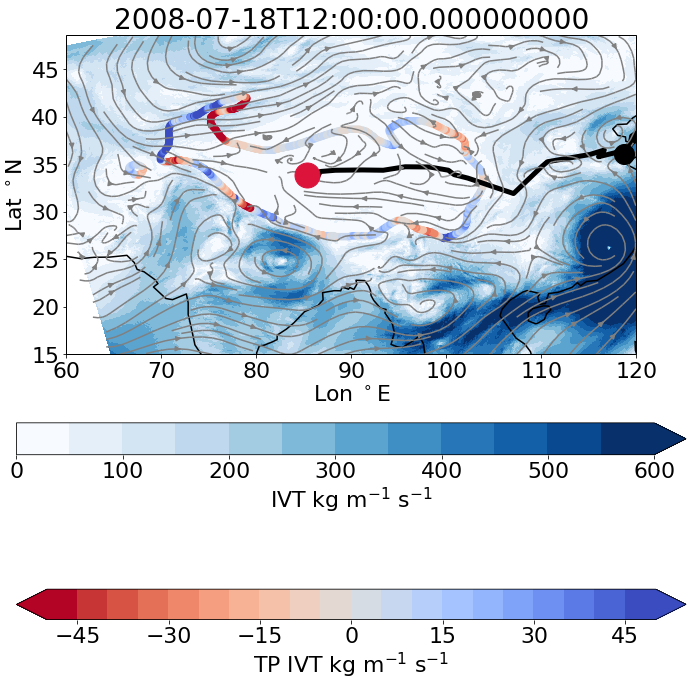

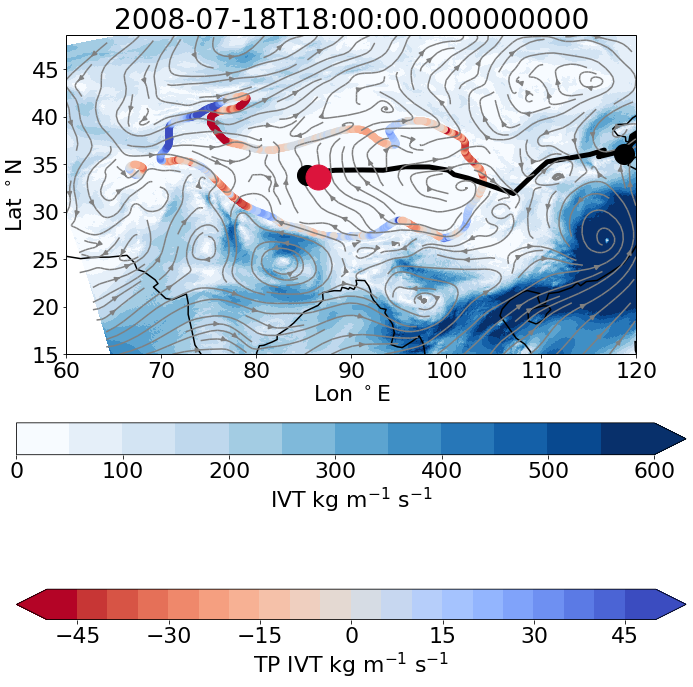

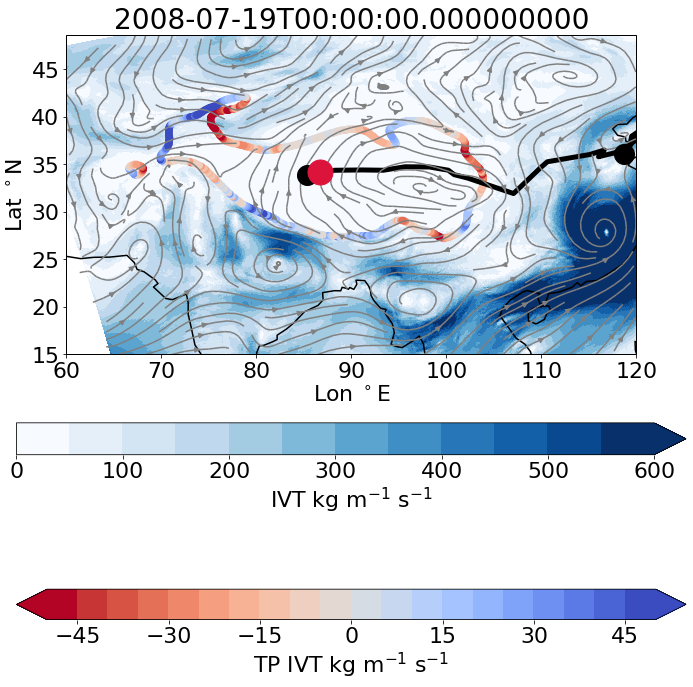

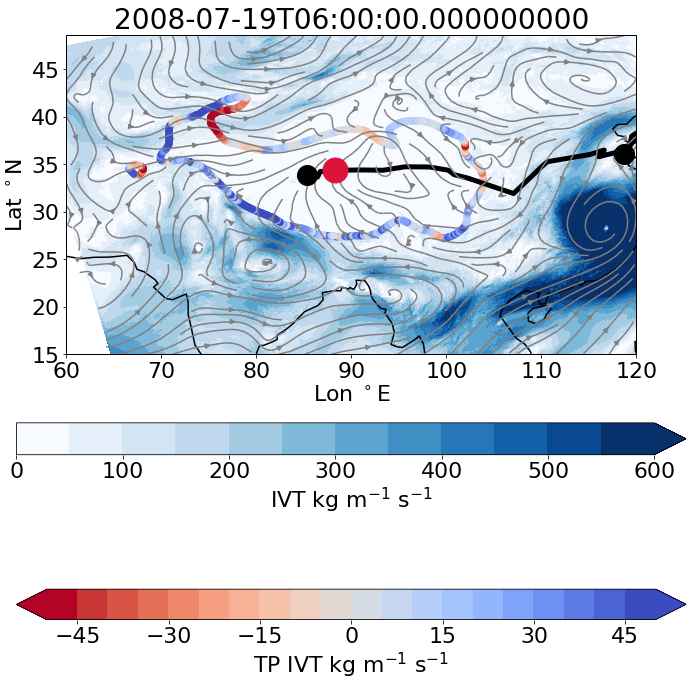

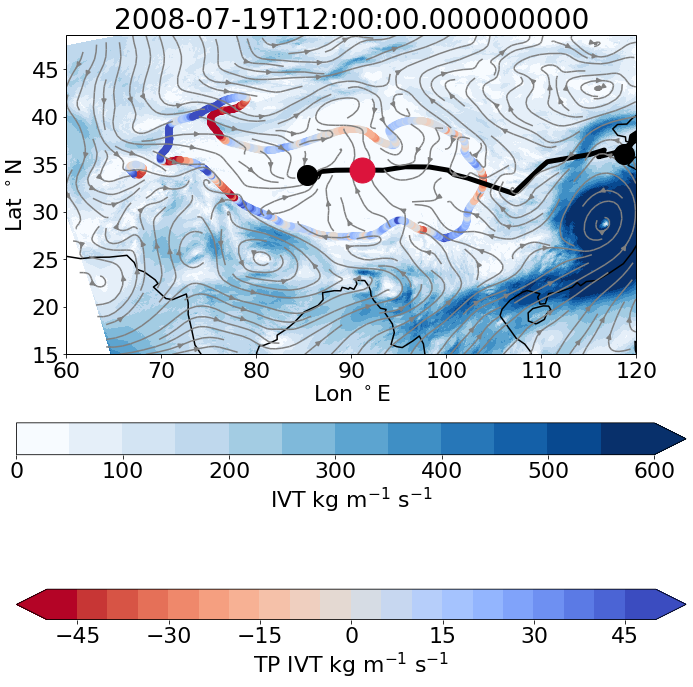

...

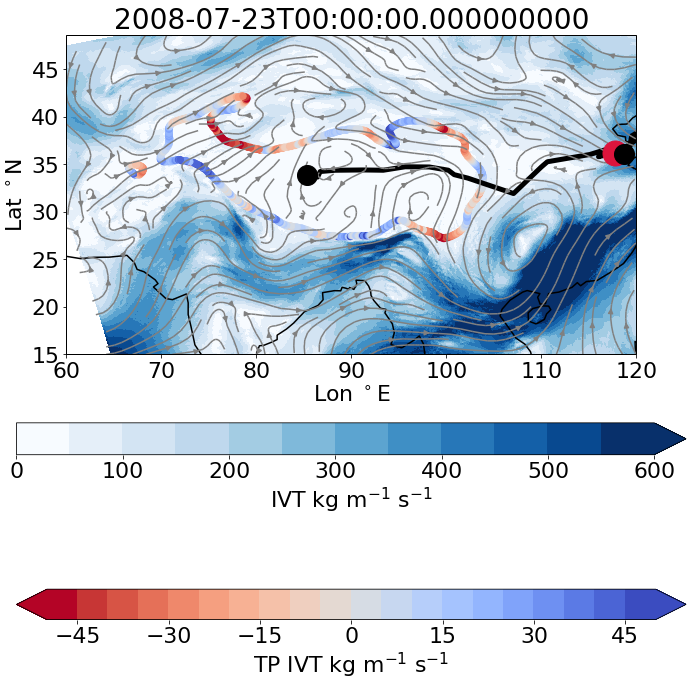

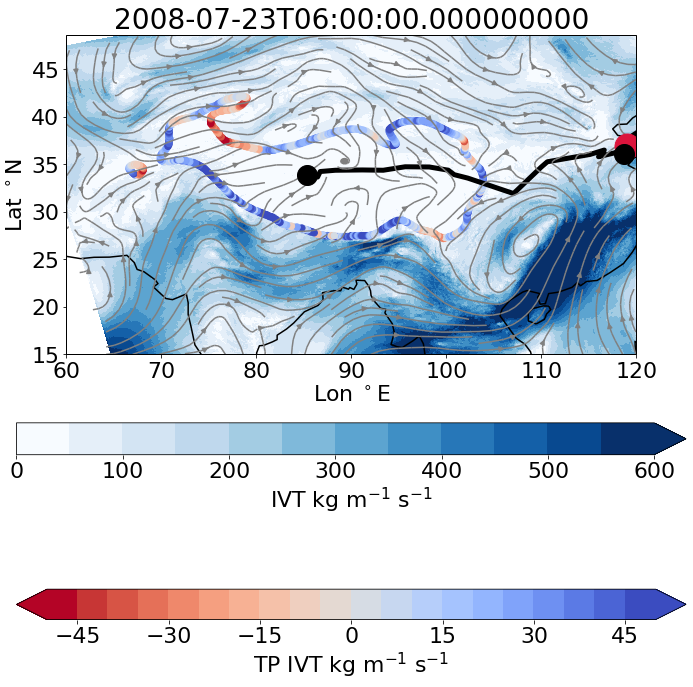

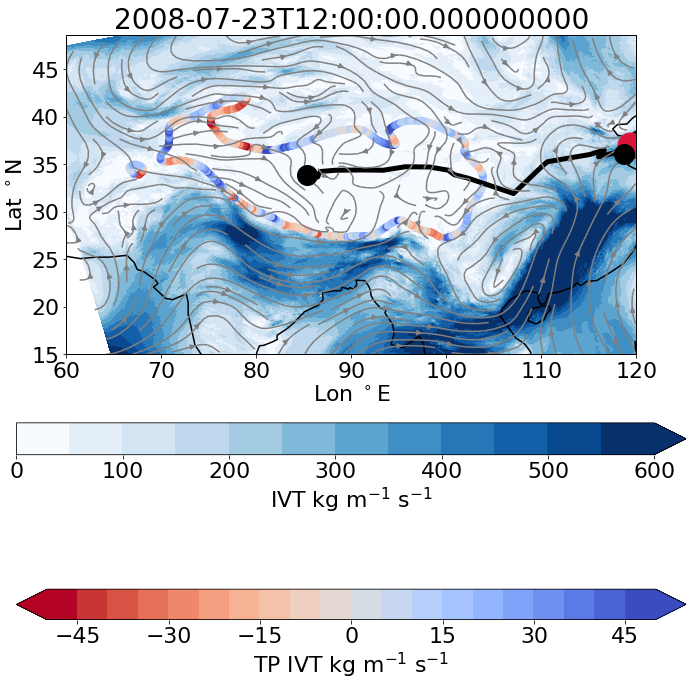

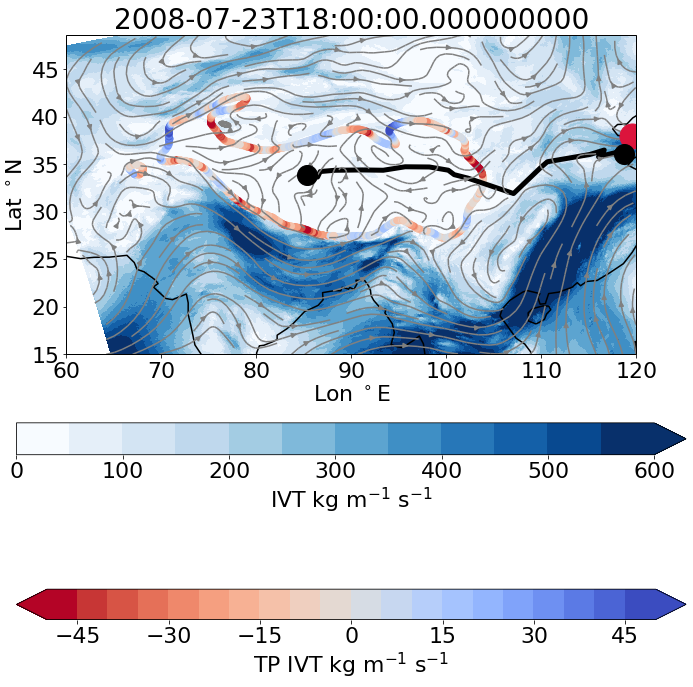

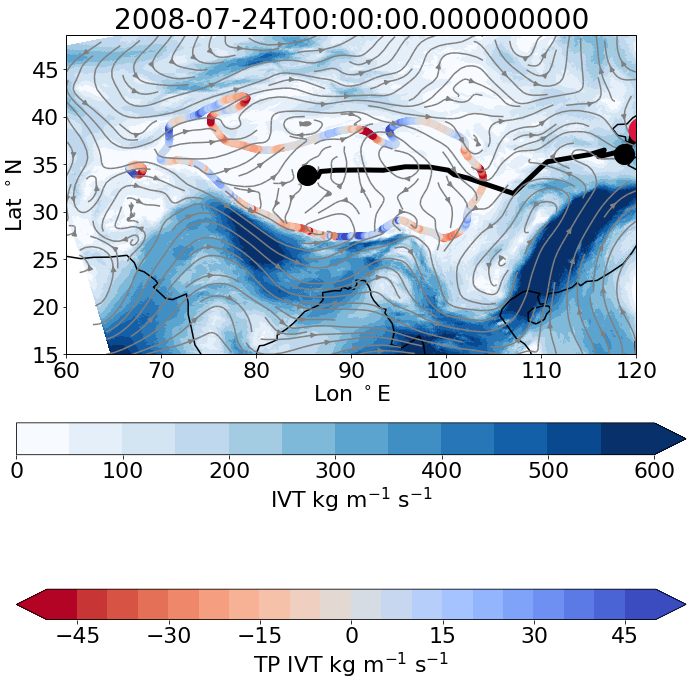

In [976]:
for time_idx in np.arange(len(file_list)):
    #### get data ### 
    data= xr.open_dataset(file_list[time_idx])

    q = data.r_v_p[0] 
    u = data.u_tr_p[0]
    v = data.v_tr_p[0]
    z = data.Z_p[0]
    t = data.T_p[0].values
    lons = data.lon.values
    lats= data.lat.values 
    pressure = data.pressure.values
    data.close()

    q=np.nan_to_num(q, 0)
    z=np.nan_to_num(z, 0)
    u=np.nan_to_num(u, 0)
    v=np.nan_to_num(v, 0)

    pressure_wrf = data.pressure.values
    data.close()

    # convert specific humidity to absolute humidity in kg/m3                                                                                          
    for plev in np.arange(29):
        p_d = (pressure[plev] * 100)/(R*t[plev])
        q[plev] =q[plev]* p_d


    q=np.nan_to_num(q, 0)
    awt_u_wrf = colint_pressure(q*u, np.flip(pressure, 0) )
    awt_v_wrf = colint_pressure(q*v, np.flip(pressure, 0) )
    q_wrf = np.sqrt(awt_u_wrf**2 + awt_v_wrf**2 )
    
    ### plot ####
    plot_awt_tpv(awt_u_wrf, awt_v_wrf, q_wrf, lons, lats, time_idx)

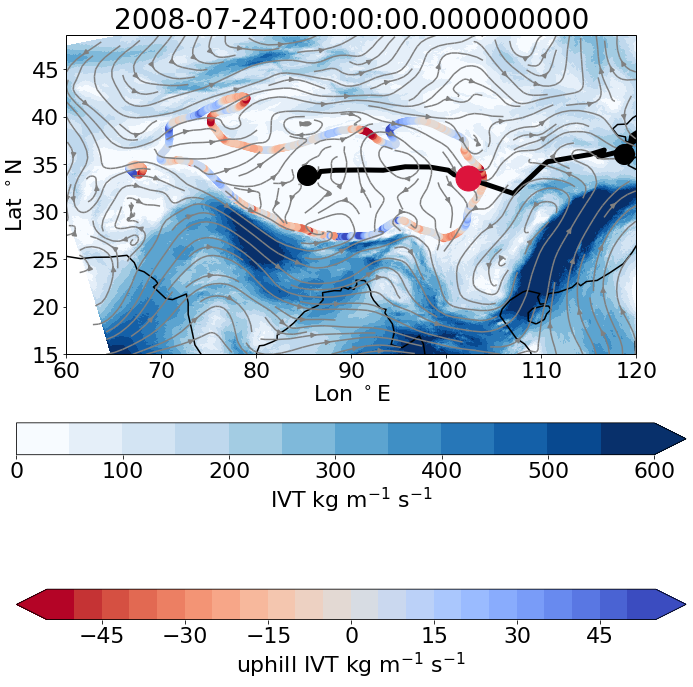

In [972]:
plot_awt_tpv(awt_u_wrf, awt_v_wrf, q_wrf, lons, lats, 10 )

In [17]:
def plot_awt_tpv(awt_u, awt_v, q, lons, lats, time_idx):

    #############plot##########################
    fig =plt.figure(figsize=(12,12))
    xlabels=[60,70,80,90,100,110]
    ylabels= [25,30,35,40,45]
    fs= 22
    c= 'k'
    # customizing of colorbar 
    cmap=plt.cm.Blues
    r = np.arange(0,650,50)
    norm = colors.BoundaryNorm(boundaries= r,  ncolors= 256)
    r2 = np.arange(-50,55,5)
    norm2 = colors.BoundaryNorm(boundaries= r2,  ncolors= 256)

    # spacing of wind vectors 

    # convert coords to 2d array 
    x,y  = lons,lats
    skip  =(slice(None,None,20),slice(None,None,20))

    # Plot ERA5 moisture transport in map 
    ax = plt.subplot(1, 1, 1, projection=ccrs.PlateCarree())
    ax.set_extent([60,115,23,34])
    ax.set_extent([60,120,15,45])
    timestr = data.time.values[0]
    ax.set_title(str(timestr), fontsize= 28 )
    ax.coastlines(linewidth = 1.5)
    #ax.contour(elevations.lon.values,elevations.lat.values, elevations.data.T, [3000], cmap = 'Greys_r')

    # Plot wind vectors 
    x,y = lons,lats
    m= ax.pcolormesh(lons, lats, q, norm=norm, cmap = cmap  )    
    ax.streamplot(x, y, awt_u, awt_v, density = 1.5 , color = 'grey', transform= ccrs.PlateCarree()) 
    lo,la = np.meshgrid(elevations.lon.values,elevations.lat.values)
    
    # calculate water transport uphill towards the TP (excluding along and downhill transport)
    dotproduct = get_awt_tpwards_tp(awt_u_wrf, awt_v_wrf, lats, lons)
    tp = ax.scatter(lo,la ,c = dotproduct, s= 40 , cmap = 'coolwarm_r', norm=norm2,  vmin=-50,vmax=50)
    #plt.rcParams.update({'font.size': fs})
    plt.colorbar(tp, extend = 'both', label = 'TP IVT kg m$^{-1}$ s$^{-1}$', orientation = 'horizontal')

       
    # TPV track 
    for key in coords.keys():
        track_lons = coords[key][0]
        track_lats =  coords[key][1]
        track = sgeom.LineString(zip(track_lons, track_lats))
        ax.add_geometries([track], ccrs.PlateCarree(),facecolor='none', edgecolor='black', linewidth= 5.0)

    # plot vorticity center of timestep 
    ax.plot(lon_t[0][0], lat_t[0][0],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')
    ax.plot(lon_t[0][time_idx], lat_t[0][time_idx],transform=ccrs.PlateCarree(), color='crimson', markersize=25,marker= 'o')
    ax.plot(lon_t[0][-1], lat_t[0][-1],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')


    # axis labels 
    ax.set_xticks(xlabels, xlabels)
    ax.set_yticks(ylabels,ylabels)
    ax.set_ylabel('Lat $^\circ$N',  fontsize=fs)
    ax.set_xlabel('Lon $^\circ$E',  fontsize=fs)    

    plt.rcParams.update({'font.size': fs})
    plt.colorbar(m, extend = 'max', label = 'IVT kg m$^{-1}$ s$^{-1}$', orientation = 'horizontal')
    plt.savefig('tpv_2008_awt/tpv_'+ str(timestr)+'_wrf_awt.png')

    plt.show()

## Calculate the amout of water transport towards the plateau during the TPV passage 

In [266]:
from scipy import ndimage 
import scipy 
from scipy.signal import convolve
import metpy 
from metpy import calc
from metpy.units import units

def get_spacing(lats, lons):
    '''This functions calculates the grid spacing in meter.
    Args:
    lats(numpy array): 1D array with latitudes
    lons(numpy array): 1D array with longitudes
    Returns:
    dlat(numpy array): latitude spacings in m 
    dlon(numpy array): longitude spacings in m 
'''
    Rad = 6371*1000
    # creating 2D fields for lats and lons 
    latitudes = np.stack([lats]*np.shape(lons)[0], axis = 1)
    longitudes = np.stack([lons]*np.shape(lats)[0], axis = 0)

    # convert lats and lons to cartesian coordinates 
    x = Rad * np.cos(np.radians(latitudes)) * np.cos(np.radians(longitudes))
    y = Rad * np.cos(np.radians(latitudes)) * np.sin(np.radians(longitudes))
    z = Rad *np.sin(np.radians(latitudes))

    # stack to get 3D array 
    cartesian = np.stack([x, y, z], axis = 2)
    # pythagorean theorem to get distances in meter
    dlat = np.sqrt(np.sum((cartesian[2:, :] - cartesian[:-2,:]) ** 2, axis=-1))
    dlon = np.sqrt(np.sum((cartesian[:, 2:] - cartesian[:,:-2]) ** 2, axis=-1))

    return dlat, dlon

def dy_dlat(y, dlat):
    '''This functions calculates the derivative along latitudes of a variable y using a finite differential method.
    Args:
    y(numpy array): atmospheric variable, e.g. u, v, q, qu, qv and so on
    dlat(np.array): grid spacing in meter, should be more or less constant'''

    k_lat = np.array([[1], [0], [-1]])
    result = convolve(y, k_lat, mode="valid") / dlat
    return result 


def dy_dlon(y, dlon):
    '''This functions calculates the derivative along longitudes of a variable y using a finite differential method.
    Args:
    y(numpy array): atmospheric variable, e.g. u, v, q, qu, qv and so on
    dlon(np.array): grid spacing in meter, should be varying dependent on latitude '''
    k_lon= np.array([[1, 0, -1]])
    result = convolve(y, k_lon, mode="valid") / dlon
    return result



In [125]:



##### 1. mask contour line #####
elevations_smoothed = ndimage.gaussian_filter(elevations, sigma = 6)
mask = elevations_smoothed >= 3000
elevations_dilated = ndimage.binary_dilation(mask)
contour_mask = mask ^ elevations_dilated 

#plt.figure(figsize=(10,7))
#plt.pcolormesh(contour_mask.T)

##### 2. get normal vector for gradient field #####

dlat, dlon  = get_spacing(latitude, longitude)
dx= dy_dlon(elevations_smoothed.T, dlon) 
dy= dy_dlat(elevations_smoothed.T, dlat)
dzdx = np.hstack([dx, np.zeros((350,2))])
dzdy = np.vstack([dy, np.zeros((2,600))])

# normalize gradient field (scipy linear algebra norm)
norm = np.sqrt(dzdx**2 + dzdy**2)
nx= np.divide(dzdx, norm)
ny = np.divide(dzdy, norm) 


/home/juli/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:28: RuntimeWarning: invalid value encountered in true_divide
/home/juli/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:29: RuntimeWarning: invalid value encountered in true_divide


In [1049]:
dotproduct = get_awt_tpwards_tp(awt_u_wrf, awt_v_wrf, lats, lons)

In [14]:
def haversine(lon1, lat1, lon2, lat2):
    # convert decimal degrees to radians
    lon1 = np.deg2rad(lon1)
    lon2 = np.deg2rad(lon2)
    lat1 = np.deg2rad(lat1)
    lat2 = np.deg2rad(lat2)

    # haversine formula
    dlon = lon2 - lon1
    dlat = lat2 - lat1
    a = np.sin(dlat/2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2
    c = 2 * np.arcsin(np.sqrt(a))
    r = 6371
    return c * r

In [12]:

def get_awt_tpwards_tp(awt_u_wrf, awt_v_wrf, lats, lons):
    # bring WRF and elevation data on the same grid 
    newlat,newlon  = np.meshgrid(latitude,longitude)
    u_int = scipy.interpolate.griddata((lats.flatten(), lons.flatten()), awt_u_wrf.flatten(), (newlat, newlon), method='linear').T
    v_int = scipy.interpolate.griddata((lats.flatten(), lons.flatten()), awt_v_wrf.flatten(), (newlat, newlon), method='linear').T

    # dot product of n vector and u and v components of water vapor transport -> map with upward water transport
    dotproduct = u_int * nx + v_int * ny

    # mask out contour line 
    dotproduct[contour_mask.T == False]= np.nan
    
    return dotproduct


In [13]:
def get_precip(tpvlon, tpvlat,lon,lat, precip, coordinate_flag = True):
    """
    Get the total precipitation within a radius around TPV center. 
    
    Args: 
    tpvlon: TPV center lon 
    tpvlat: TPV center lat 
    lon(str): name of longitude field of input xarray 
    lat(str): name of latitude field of input xarray
    precip: precip field of input xarray 
    
    """
    if lon == 'lon' and lat == 'lat':
        if coordinate_flag is False:
            array = np.asarray(precip.lat.values.flatten())
            idx = (np.abs(array - tpvlat)).argmin()
            tlat = array[idx]
            array = np.asarray(precip.lon.values.flatten())
            idx = (np.abs(array - tpvlon)).argmin()
            tlon = array[idx]

        else: 
        
            tlon = precip.sel(lon = tpvlon, lat= tpvlat, method = 'nearest').lon.values
            tlat = precip.sel(lon = tpvlon, lat= tpvlat, method = 'nearest').lat.values
            
        lon = precip.lon
        lat = precip.lat
        
    elif lon == 'longitude' and lat == 'latitude':
        tlon = precip.sel(longitude = tpvlon, latitude = tpvlat, method = 'nearest').longitude.values
        tlat = precip.sel(longitude = tpvlon, latitude = tpvlat, method = 'nearest').latitude.values
        lon = precip.longitude
        lat = precip.latitude
    else:
        'name for coordinates not supported.'

    distances = haversine(tlon, tlat, lon, lat)
    mask = (distances <= 300.0)
    
    return np.nanmean(precip.where(mask).values) 

In [799]:
# check whether all arrows point inside 
cx = nx.copy()
cy = ny.copy()
cx[~contour_mask.T] = np.nan
cy[~contour_mask.T] = np.nan
plt.figure(figsize= (15,10))
plt.quiver(longitude, latitude, cx,  cy, scale= 20)

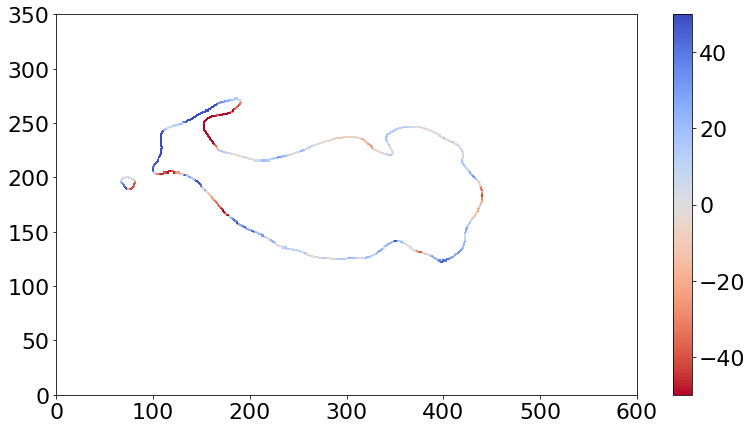

In [818]:
plt.figure(figsize= (13,7))
plt.pcolormesh(dotproduct, vmin = -50, vmax = 50, cmap = 'coolwarm_r')
plt.colorbar()

In [815]:
### calculate total water tansport with weights 

# weighting with pixel width (because wind whcih comes from angle contributes more)
dlo = np.hstack([dlon, np.zeros((350,2))])
dla = np.vstack([dlat, np.zeros((2,600))])
weights = (dlo/2) *nx + (dla/2) *ny

# calculate sum to get the total amount of water vapor transport 
total_tp_awt = np.nansum(dotproduct*weights)
total_tp_awt

46285852.092599586

## Simulation: compare water inwards transport ERA5 and WRF 

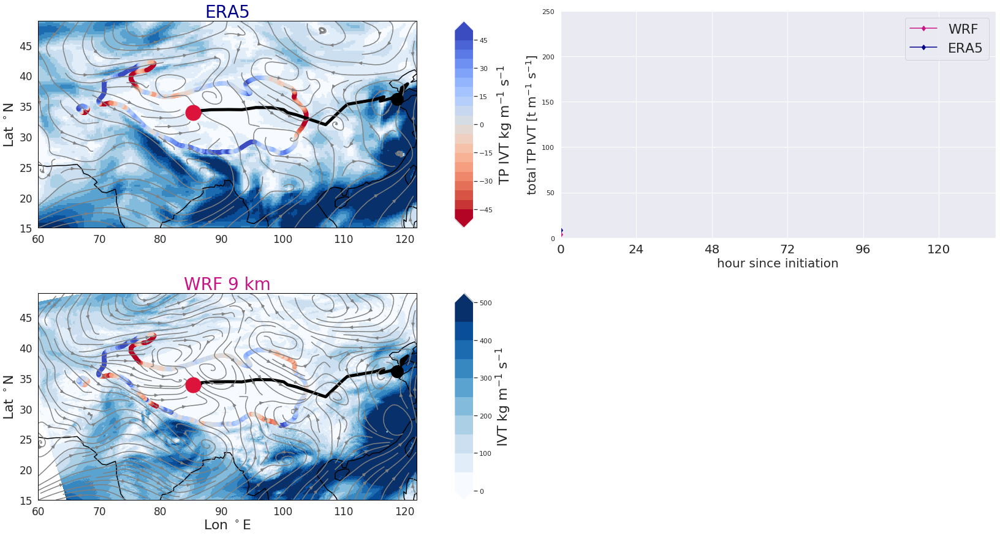

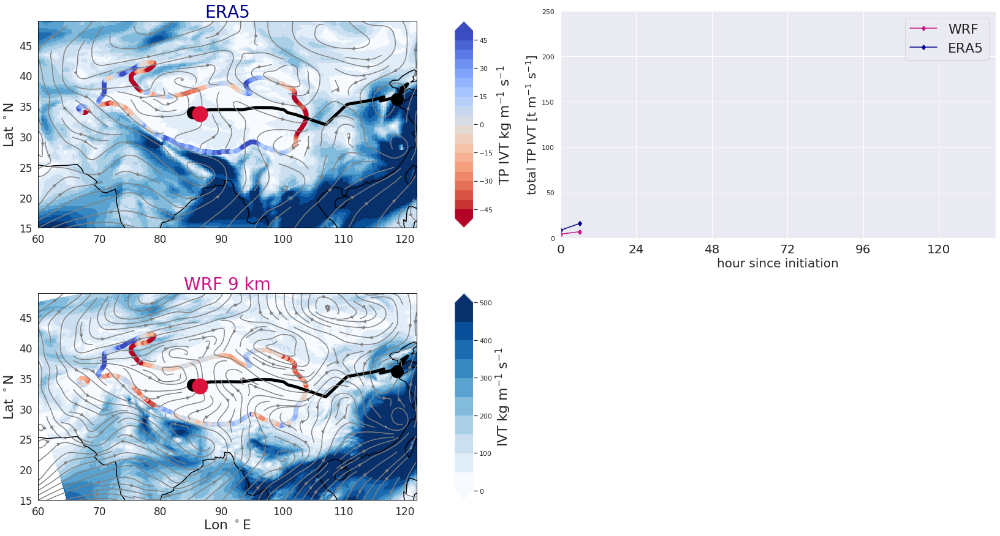

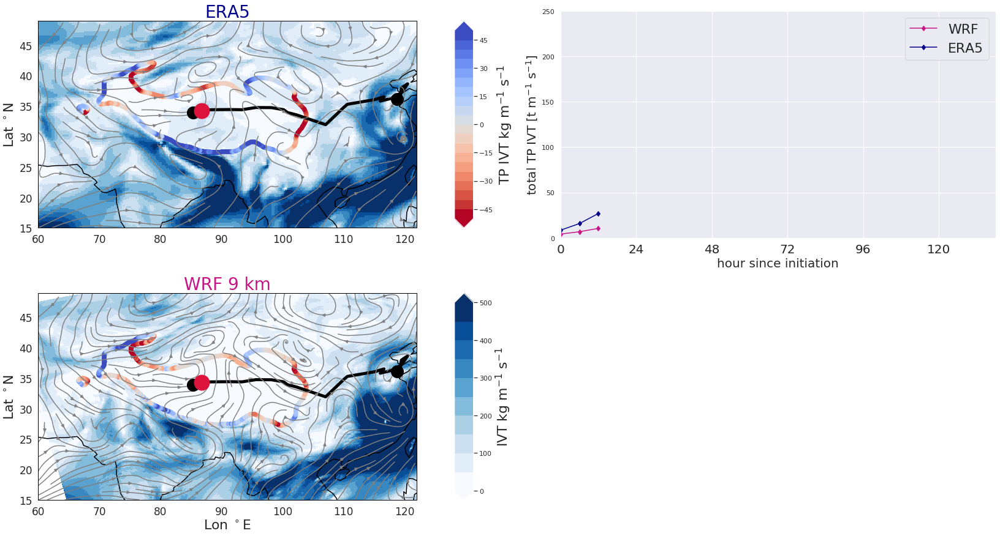

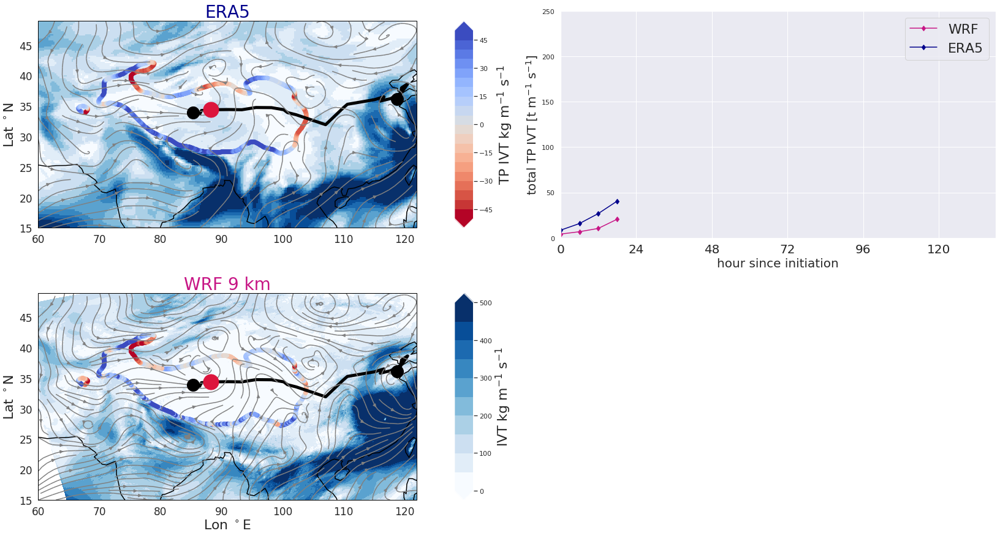

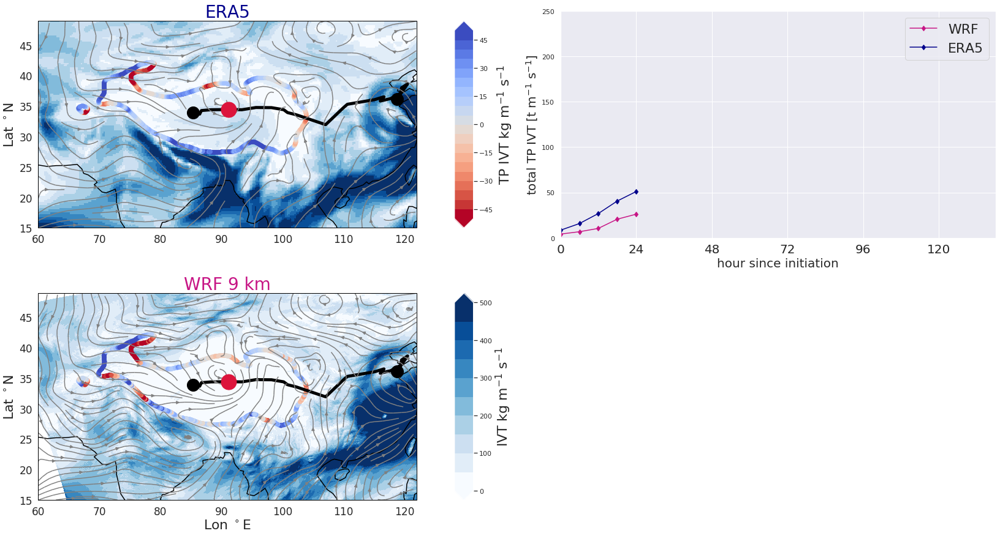

...

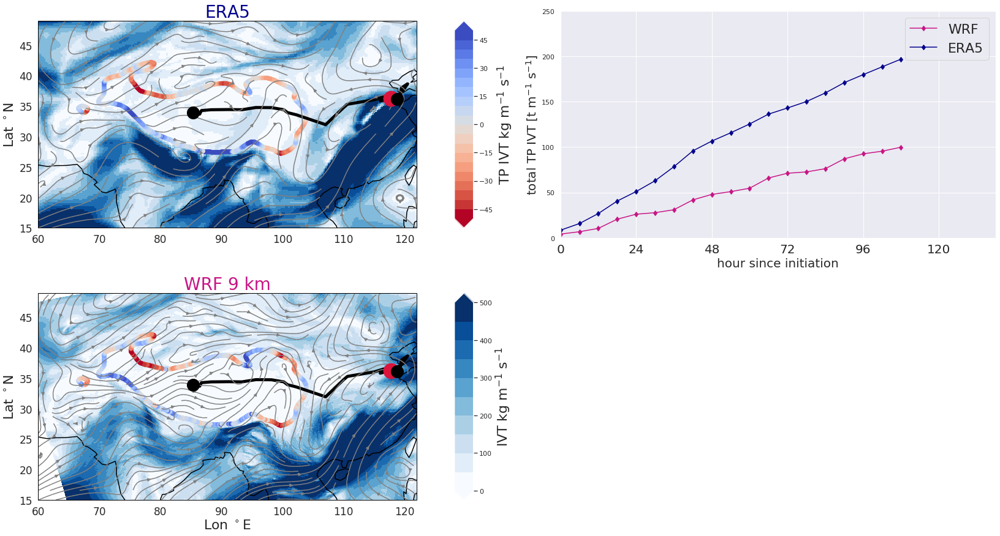

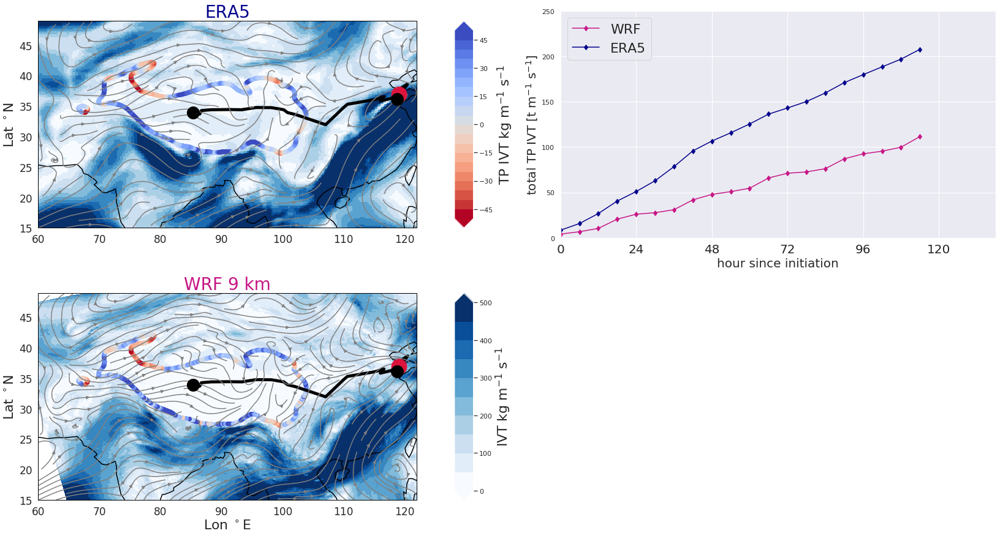

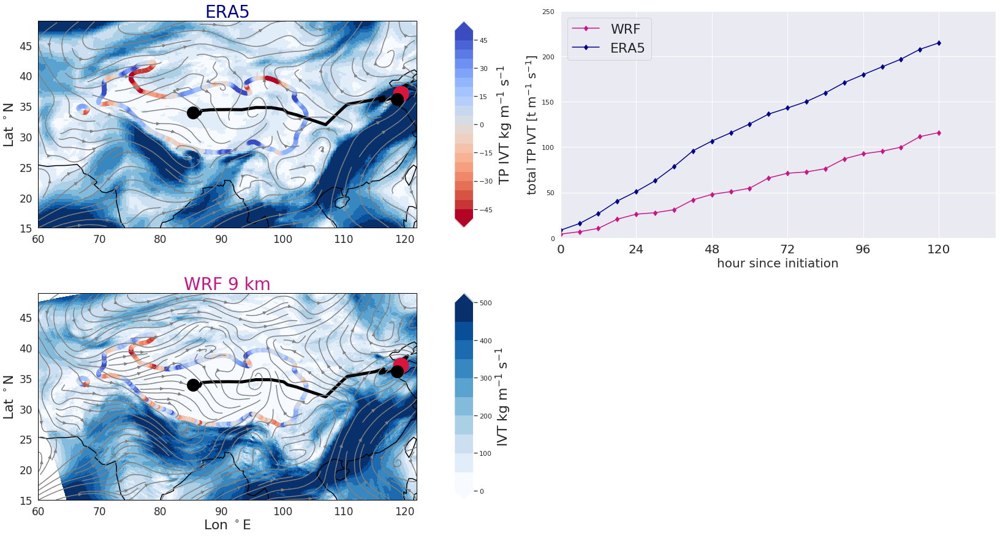

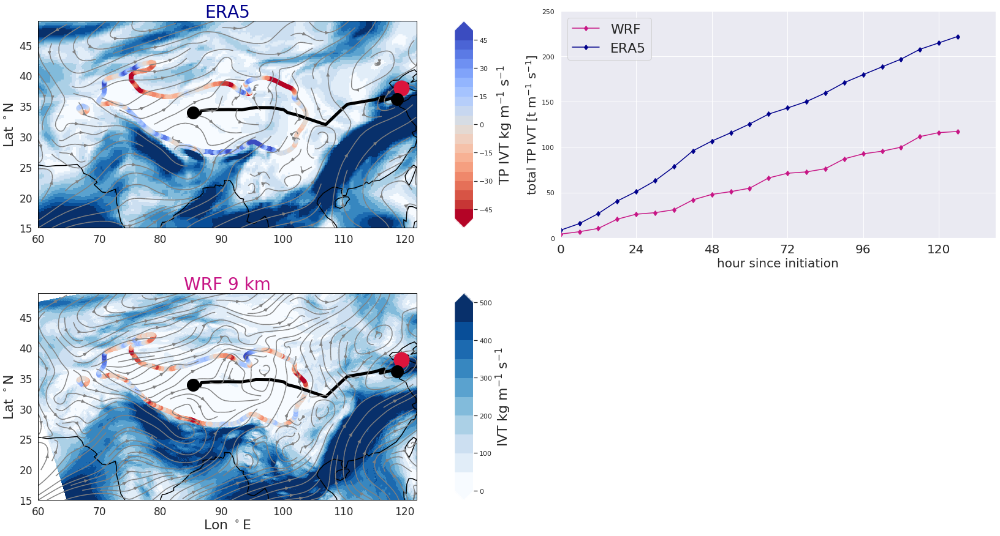

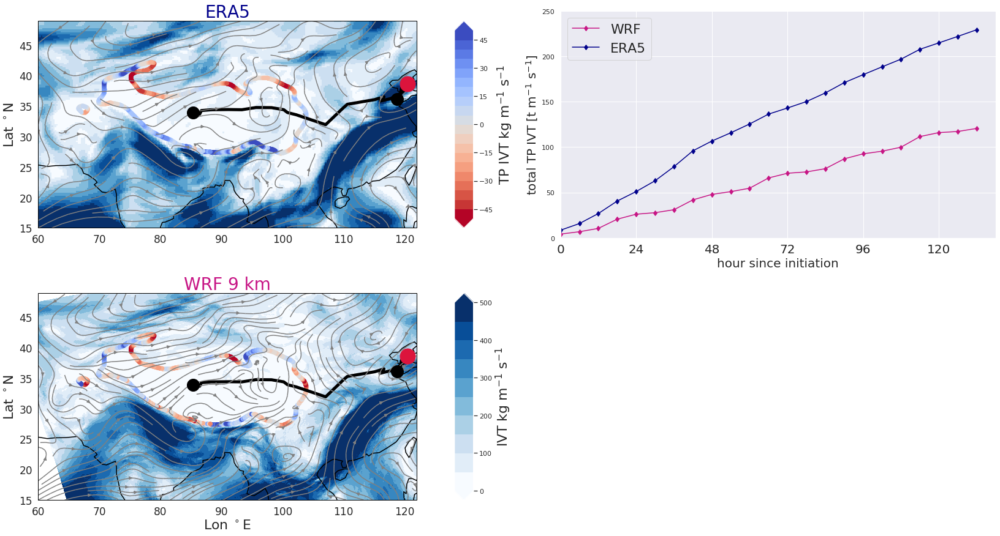

In [1164]:
wrf_inflow= np.zeros(len(file_list))
wrf_inflow[:] = np.nan
era_inflow= np.zeros(len(file_list))
era_inflow[:] = np.nan

for time_idx in np.arange(len(file_list)):
    file1= era_file_list[time_idx]
    file2 = file_list[time_idx]
    plot_comparison(file1, file2, times, time_idx)
    

In [11]:
def plot_comparison(file1, file2, times, time_idx):
    ### ERA5 ####
    dataset = xr.open_dataset(file1, decode_times=False)
    awt_u= dataset['p71.162'][0].values
    awt_v= dataset['p72.162'][0].values
    lon = dataset.longitude.values
    lat = dataset.latitude.values
    lons,lats= np.meshgrid(lon,lat)
    q_clim = np.abs(awt_u) + np.abs(awt_v)
    dataset.close()
    
    ### WRF ### 
    data= xr.open_dataset(file2)
    q = data.r_v_p[0] 
    u = data.u_tr_p[0]
    v = data.v_tr_p[0]
    z = data.Z_p[0]
    t = data.T_p[0].values
    wlons = data.lon.values
    wlats= data.lat.values 
    pressure = data.pressure.values
    data.close()
    q=np.nan_to_num(q, 0)
    z=np.nan_to_num(z, 0)
    u=np.nan_to_num(u, 0)
    v=np.nan_to_num(v, 0)
    pressure_wrf = data.pressure.values
    data.close()

    # convert specific humidity to absolute humidity in kg/m3                                                                                          
    for plev in np.arange(29):
        p_d = (pressure[plev] * 100)/(R*t[plev])
        q[plev] =q[plev]* p_d


    q=np.nan_to_num(q, 0)
    awt_u_wrf = colint_pressure(q*u, np.flip(pressure, 0) )
    awt_v_wrf = colint_pressure(q*v, np.flip(pressure, 0) )
    q_wrf = np.sqrt(awt_u_wrf**2 + awt_v_wrf**2 )
    
    ################### plot ######################
    plt.figure(figsize= (28,15))
    timestr = times[0][time_idx]
    plt.title(str(timestr), fontsize= 17 )

    # labels, fontsize, color 
    xlabels=[60,70,80,90,100,110,120]
    ylabels= [15,20,25,30,35,40,45]
    fs= 22
    c= 'k'
    # customizing of colorbar 
    cmap=plt.cm.Blues
    r = np.arange(0,550,50)
    norm = colors.BoundaryNorm(boundaries= r,  ncolors= 256)
    r2 = np.arange(-50,55,5)
    norm2 = colors.BoundaryNorm(boundaries= r2,  ncolors= 256)
    # convert coords to 2d array 
    x,y  = lons,lats
    skip  =(slice(None,None,4),slice(None,None,4))

    # Plot ERA5 moisture transport in map 
    ax = plt.subplot(2, 2, 1, projection=ccrs.PlateCarree())
    ax.set_extent([60,122,15,45])
    ax.set_title('ERA5', fontsize= 28, color = 'darkblue')
    ax.coastlines(linewidth = 1.5)
    lo,la = np.meshgrid(elevations.lon.values,elevations.lat.values)
    m= ax.pcolormesh(lons, lats, q_clim,norm = norm, cmap = cmap) 
    ax.streamplot(lons, lats, awt_u, awt_v, color = 'grey', transform= ccrs.PlateCarree())  
    # calculate water transport uphill towards the TP (excluding along and downhill transport)
    dotproduct1 = get_awt_tpwards_tp(awt_u, awt_v, lats, lons)
    tp = ax.scatter(lo,la,c = dotproduct1.copy(), s= 40 , cmap = 'coolwarm_r', norm=norm2,  vmin=-50,vmax=50)
    # axis labels 
    ax.set_xticks(xlabels, xlabels)
    ax.set_yticks(ylabels,ylabels)
    ax.set_xticklabels(xlabels, fontsize= 17)
    ax.set_yticklabels(ylabels, fontsize= 17)
    ax.set_ylabel('Lat $^\circ$N',  fontsize=fs)
     
    # TPV track 
    for key in coords.keys():
        track_lons = coords[key][0]
        track_lats =  coords[key][1]
        track = sgeom.LineString(zip(track_lons, track_lats))
        ax.add_geometries([track], ccrs.PlateCarree(),facecolor='none', edgecolor='black', linewidth= 5.0)

    # plot vorticity center of timestep 
    ax.plot(lon_t[0][0], lat_t[0][0],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')
    ax.plot(lon_t[0][time_idx], lat_t[0][time_idx],transform=ccrs.PlateCarree(), color='crimson', markersize=25,marker= 'o')
    ax.plot(lon_t[0][-1], lat_t[0][-1],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')

    ### WRF subplot ###
    xlabels=[60,70,80,90,100,110,120]
    ylabels= [15,20,25,30,35,40,45]
    ax2 = plt.subplot(2, 2, 3, projection=ccrs.PlateCarree())
    ax2.set_extent([60,122,15,45])
    ax2.set_title('WRF 9 km', fontsize = 28, color ='mediumvioletred')
    timestr = data.time.values[0]
    ax2.coastlines(linewidth = 1.5)
    # Plot wind vectors 
    m= ax2.pcolormesh(wlons, wlats, q_wrf, norm=norm, cmap = cmap  )    
    ax2.streamplot(x, y, awt_u, awt_v, density = 1.5 , color = 'grey', transform= ccrs.PlateCarree()) 
    # calculate water transport uphill towards the TP (excluding along and downhill transport)
    dotproduct2 = get_awt_tpwards_tp(awt_u_wrf, awt_v_wrf, wlats, wlons)
    tp = ax2.scatter(lo,la ,c = dotproduct2.copy(), s= 40 , cmap = 'coolwarm_r', norm=norm2,  vmin=-50,vmax=50)      
    # TPV track 
    for key in coords.keys():
        track_lons = coords[key][0]
        track_lats =  coords[key][1]
        track = sgeom.LineString(zip(track_lons, track_lats))
        ax2.add_geometries([track], ccrs.PlateCarree(),facecolor='none', edgecolor='black', linewidth= 5.0)

    # plot vorticity center of timestep 
    ax2.plot(lon_t[0][0], lat_t[0][0],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')
    ax2.plot(lon_t[0][time_idx], lat_t[0][time_idx],transform=ccrs.PlateCarree(), color='crimson', markersize=25,marker= 'o')
    ax2.plot(lon_t[0][-1], lat_t[0][-1],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')
    # axis labels 
    ax2.set_xticks(xlabels, xlabels)
    ax2.set_xticklabels(xlabels, fontsize= 17)
    ax2.set_yticks(ylabels,ylabels)
    ax2.set_yticklabels(ylabels, fontsize= 17)
    ax2.set_ylabel('Lat $^\circ$N',  fontsize=fs)
    ax2.set_xlabel('Lon $^\circ$E',  fontsize=fs)    
    


    ### plot the water inflow ###
    dotproduct1[ newlat.T > 35]  = np.nan
    summa = np.nansum(dotproduct1[dotproduct1 > 0 ])
    era_inflow[time_idx] = np.nansum([summa, era_inflow[time_idx - 1]]) 
    dotproduct2[ newlat.T > 35]  = np.nan
    summa = np.nansum(dotproduct2[dotproduct2 > 0 ])
    wrf_inflow[time_idx] = np.nansum([summa, wrf_inflow[time_idx - 1]]) 
    
    ax3 = plt.subplot(2, 2, 2)
    sns.set()
    ax3.plot(np.arange(len(file_list)), wrf_inflow / 1000, marker = 'd', color = 'mediumvioletred', label = 'WRF')
    ax3.plot(np.arange(len(file_list)), era_inflow / 1000, marker = 'd', color = 'darkblue', label = 'ERA5')
    ax3.set_xlabel('hour since initiation', fontsize = 20)
    ax3.set_ylabel('total TP IVT [t m$^{-1}$ s$^{-1}$]', fontsize= 20)
    ax3.grid('on')
    ax3.set_xlim(0,23)
    ax3.set_ylim(0, 250)   
    ax3.set_xticks(np.arange(23)[::4])
    ax3.set_xticklabels(np.arange(23)[::4]*6, fontsize = 20)
    ax3.legend(fontsize= 22)

    # colorbar and fontsize 
    plt.rcParams.update({'font.size': fs})
    cbar = make_colorbar(ax, tp, orientation='vertical')
    cbar.set_label('TP IVT kg m$^{-1}$ s$^{-1}$', fontsize = fs)
    cbar = make_colorbar(ax2, m, orientation='vertical')
    cbar.set_label('IVT kg m$^{-1}$ s$^{-1}$', fontsize = fs)    
    
    plt.savefig('tpv_2008_awt/tpv_'+ str(timestr)+'_wrf_era5.png')
    plt.show()

In [18]:
def make_colorbar(ax, mappable, **kwargs):
    from mpl_toolkits.axes_grid1 import make_axes_locatable
    import matplotlib as mpl

    divider = make_axes_locatable(ax)
    orientation = kwargs.pop('orientation', 'vertical')
    if orientation == 'vertical':
        loc = 'right'
    elif orientation == 'horizontal':
        loc = 'bottom'
        
    cax = divider.append_axes(loc, '5%', pad='10%', axes_class=mpl.pyplot.Axes)
    cbar = ax.get_figure().colorbar(mappable, cax=cax, orientation=orientation, extend = 'both')
    return cbar

In [191]:
def plot_comparison_precip(file1, file2, times, time_idx):
    ### ERA5 ####
    dataset = xr.open_dataset(file1, decode_times=False)
    awt_u= dataset['p71.162'][0].values
    awt_v= dataset['p72.162'][0].values
    lon = dataset.longitude.values
    lat = dataset.latitude.values
    lons,lats= np.meshgrid(lon,lat)
    q_clim = np.abs(awt_u) + np.abs(awt_v)
    dataset.close()
    
    ### WRF ### 
    data= xr.open_dataset(file2)
    q = data.r_v_p[0] 
    u = data.u_tr_p[0]
    v = data.v_tr_p[0]
    z = data.Z_p[0]
    t = data.T_p[0].values
    wlons = data.lon.values
    wlats= data.lat.values 
    pressure = data.pressure.values
    data.close()
    q=np.nan_to_num(q, 0)
    z=np.nan_to_num(z, 0)
    u=np.nan_to_num(u, 0)
    v=np.nan_to_num(v, 0)
    pressure_wrf = data.pressure.values
    data.close()

    # convert specific humidity to absolute humidity in kg/m3                                                                                          
    for plev in np.arange(29):
        p_d = (pressure[plev] * 100)/(R*t[plev])
        q[plev] =q[plev]* p_d


    q=np.nan_to_num(q, 0)
    awt_u_wrf = colint_pressure(q*u, np.flip(pressure, 0) )
    awt_v_wrf = colint_pressure(q*v, np.flip(pressure, 0) )
    q_wrf = np.sqrt(awt_u_wrf**2 + awt_v_wrf**2 )
    
    ################### plot ######################
    plt.figure(figsize= (28,15))
    timestr = times[0][time_idx]
    plt.title(str(timestr), fontsize= 17 )

    # labels, fontsize, color 
    xlabels=[60,70,80,90,100,110,120]
    ylabels= [15,20,25,30,35,40,45]
    fs= 22
    c= 'k'
    # customizing of colorbar 
    cmap=plt.cm.Blues
    r = np.arange(0,550,50)
    norm = colors.BoundaryNorm(boundaries= r,  ncolors= 256)
    r2 = np.arange(-50,55,5)
    norm2 = colors.BoundaryNorm(boundaries= r2,  ncolors= 256)
    # convert coords to 2d array 
    x,y  = lons,lats
    skip  =(slice(None,None,4),slice(None,None,4))

    # Plot ERA5 moisture transport in map 
    ax = plt.subplot(2, 2, 1, projection=ccrs.PlateCarree())
    ax.set_extent([60,122,15,45])
    ax.set_title('ERA5', fontsize= 28, color = 'darkblue')
    ax.coastlines(linewidth = 1.5)
    lo,la = np.meshgrid(elevations.lon.values,elevations.lat.values)
    m= ax.pcolormesh(lons, lats, q_clim,norm = norm, cmap = cmap) 
    ax.streamplot(lons, lats, awt_u, awt_v, color = 'grey', transform= ccrs.PlateCarree())  
    # calculate water transport uphill towards the TP (excluding along and downhill transport)
    dotproduct1 = get_awt_tpwards_tp(awt_u, awt_v, lats, lons)
    tp = ax.scatter(lo,la,c = dotproduct1.copy(), s= 40 , cmap = 'coolwarm_r', norm=norm2,  vmin=-50,vmax=50)
    # axis labels 
    ax.set_xticks(xlabels, xlabels)
    ax.set_yticks(ylabels,ylabels)
    ax.set_xticklabels(xlabels, fontsize= 17)
    ax.set_yticklabels(ylabels, fontsize= 17)
    ax.set_ylabel('Lat $^\circ$N',  fontsize=fs)
     
    # TPV track 
    for key in coords.keys():
        track_lons = coords[key][0]
        track_lats =  coords[key][1]
        track = sgeom.LineString(zip(track_lons, track_lats))
        ax.add_geometries([track], ccrs.PlateCarree(),facecolor='none', edgecolor='black', linewidth= 5.0)

    # plot vorticity center of timestep 
    ax.plot(lon_t[0][0], lat_t[0][0],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')
    ax.plot(lon_t[0][time_idx], lat_t[0][time_idx],transform=ccrs.PlateCarree(), color='crimson', markersize=25,marker= 'o')
    ax.plot(lon_t[0][-1], lat_t[0][-1],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')

    ### WRF subplot ###
    xlabels=[60,70,80,90,100,110,120]
    ylabels= [15,20,25,30,35,40,45]
    ax2 = plt.subplot(2, 2, 3, projection=ccrs.PlateCarree())
    ax2.set_extent([60,122,15,45])
    ax2.set_title('WRF 9 km', fontsize = 28, color ='mediumvioletred')
    timestr = data.time.values[0]
    ax2.coastlines(linewidth = 1.5)
    # Plot wind vectors 
    m= ax2.pcolormesh(wlons, wlats, q_wrf, norm=norm, cmap = cmap  )    
    ax2.streamplot(x, y, awt_u, awt_v, density = 1.5 , color = 'grey', transform= ccrs.PlateCarree()) 
    # calculate water transport uphill towards the TP (excluding along and downhill transport)
    dotproduct2 = get_awt_tpwards_tp(awt_u_wrf, awt_v_wrf, wlats, wlons)
    tp = ax2.scatter(lo,la ,c = dotproduct2.copy(), s= 40 , cmap = 'coolwarm_r', norm=norm2,  vmin=-50,vmax=50)      

    # TPV track 
    for key in coords.keys():
        track_lons = coords[key][0]
        track_lats =  coords[key][1]
        track = sgeom.LineString(zip(track_lons, track_lats))
        ax2.add_geometries([track], ccrs.PlateCarree(),facecolor='none', edgecolor='black', linewidth= 5.0)

    # plot vorticity center of timestep 
    ax2.plot(lon_t[0][0], lat_t[0][0],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')
    ax2.plot(lon_t[0][time_idx], lat_t[0][time_idx],transform=ccrs.PlateCarree(), color='crimson', markersize=25,marker= 'o')
    ax2.plot(lon_t[0][-1], lat_t[0][-1],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')
    # axis labels 
    ax2.set_xticks(xlabels, xlabels)
    ax2.set_xticklabels(xlabels, fontsize= 17)
    ax2.set_yticks(ylabels,ylabels)
    ax2.set_yticklabels(ylabels, fontsize= 17)
    ax2.set_ylabel('Lat $^\circ$N',  fontsize=fs)
    ax2.set_xlabel('Lon $^\circ$E',  fontsize=fs)
    
    ### get precipitation data ### 
    # GPM 
    tpvlon = lon_t[0][time_idx]
    tpvlat = lat_t[0][time_idx]
    gpm = xr.open_dataset(gpm_files[time_idx])
    gpmprecip = gpm['precipitationCal']
    gpm_precip[time_idx] = get_precip(tpvlon, tpvlat,'lon','lat', gpmprecip)+ gpm_precip[time_idx-1]
    if time_idx == 0:
        gpm_precip[time_idx] = get_precip(tpvlon, tpvlat,'lon','lat', gpmprecip)

    # ERA5 
    era = xr.open_dataset(era_files[time_idx])
    eraprecip = era['tp']
    era_precip[time_idx]= get_precip(tpvlon, tpvlat,'longitude','latitude', eraprecip) + era_precip[time_idx-1]
    if time_idx == 0:
        era_precip[time_idx] = get_precip(tpvlon, tpvlat,'lon','lat', eraprecip)
    # WRF 9km 
    wrf = xr.open_dataset(wrf_files[time_idx])
    wrfprecip = wrf['precip_g'][0]
    wrf_precip[time_idx] = get_precip(tpvlon, tpvlat,'lon','lat', wrfprecip, coordinate_flag = False ) + wrf_precip[time_idx-1]
    if time_idx == 0:
        era_precip[time_idx] = get_precip(tpvlon, tpvlat,'lon','lat', wrfprecip)
    
    ### plot precipitation within radius ###
    ax3 = plt.subplot(2, 2, 2)
    sns.set()
    ax3.plot(np.arange(len(file_list)), wrf_precip * 6, marker = 'd', color = 'mediumvioletred', label = 'WRF')
    ax3.plot(np.arange(len(file_list)), era_precip * 6 * 1000, marker = 'd', color = 'darkblue', label = 'ERA5')
    ax3.plot(np.arange(len(file_list)), gpm_precip * 6, marker = 'd', color = 'teal', label = 'GPM')
    
    ax3.set_xlabel('hour since initiation', fontsize = 20)
    ax3.set_ylabel('accumulated precip within 3$^\circ$ [mm]', fontsize= 20)
    ax3.grid('on')
    ax3.set_xlim(0,23)
    ax3.set_ylim(0, 50000)   
    ax3.set_xticks(np.arange(23)[::4])
    ax3.set_xticklabels(np.arange(23)[::4]*6, fontsize = 20)
    ax3.legend(fontsize= 22)

    # colorbar and fontsize 
    cbar = make_colorbar(ax, tp, orientation='vertical')
    cbar.set_label('TP IVT kg m$^{-1}$ s$^{-1}$', fontsize = fs)
    cbar = make_colorbar(ax2, m, orientation='vertical')
    cbar.set_label('IVT kg m$^{-1}$ s$^{-1}$', fontsize = fs)    
    
    plt.savefig('tpv_2008_awt/tpv_'+ str(timestr)+'_precip_comparison.png')
    plt.show()

In [116]:
### testing precip calculation 

wrf_precip= np.zeros(len(file_list))
wrf4km_precip= np.zeros(len(file_list))
era_precip= np.zeros(len(file_list))
gpm_precip= np.zeros(len(file_list))

for time_idx in np.arange(23):
    # GPM 
    tpvlon = lon_t[0][time_idx]
    tpvlat = lat_t[0][time_idx]
    gpm = xr.open_dataset(gpm_files[time_idx])
    gpmprecip = gpm['precipitationCal'][0]
    gpm_precip[time_idx] = get_precip(tpvlon, tpvlat,'lon','lat', gpmprecip) +  gpm_precip[time_idx-1]
    # ERA5 
    era = xr.open_dataset(era_files[time_idx])
    eraprecip = era['tp'][0]
    era_precip[time_idx]= get_precip(tpvlon, tpvlat,'longitude','latitude', eraprecip)* 1000 +  era_precip[time_idx-1]
    # WRF 9 km
    wrf = xr.open_dataset(wrf_files[time_idx])
    wrfprecip = wrf['precip_g'][0]
    wrf_precip[time_idx] = get_precip(tpvlon, tpvlat,'lon','lat', wrfprecip, coordinate_flag = False )+  wrf_precip[time_idx-1]
    # WRF 4km
    wrf4km = xr.open_dataset(wrf4km_files[time_idx])
    wrf4kmprecip = wrf4km['pr'][0] * 1000 
    wrf4km_precip[time_idx] = get_precip(tpvlon, tpvlat,'lon','lat', wrf4kmprecip, coordinate_flag = False )+  wrf_precip[time_idx-1]

## Accumulated precipitation

In [294]:
wrf = xr.open_dataset('tpv_2008_awt/wrf_accumulated_prcp.nc')['precip_g'][0] *6
gpm = xr.open_dataset('tpv_2008_awt/gpm_accumulated_prcp.nc')['precipitationCal'][0] *6
era = xr.open_dataset('tpv_2008_awt/era_accumulated_prcp.nc')['tp'][0] * 1000 *6 
eralons = xr.open_dataset('tpv_2008_awt/era_accumulated_prcp.nc')['longitude']
eralats = xr.open_dataset('tpv_2008_awt/era_accumulated_prcp.nc')['latitude']
eralon,eralat = np.meshgrid(eralons,eralats)
ugot = xr.open_dataset('../data/model/CPTP/r1i1p1/CPTP_UGOT_accumulated_precip.nc')
wrf4km = ugot['pr'][0] * 1000 *6
wrflons = ugot.lon
wrflats = ugot.lat

In [243]:
# fraction of convective precipitation 
conv = xr.open_dataset('tpv_2008_awt/era_accumulated_prcp.nc')['crr'][0] * 1000 *6
lsprecip = xr.open_dataset('tpv_2008_awt/era_accumulated_prcp.nc')['lsrr'][0] * 1000 *6
lsfraction = lsprecip/era * 100
cfraction = conv/era * 100
total = lsprecip + conv
mask = np.ma.masked_where(eralon,cfraction < 10)
los = eralon[mask]
las = eralat[mask]

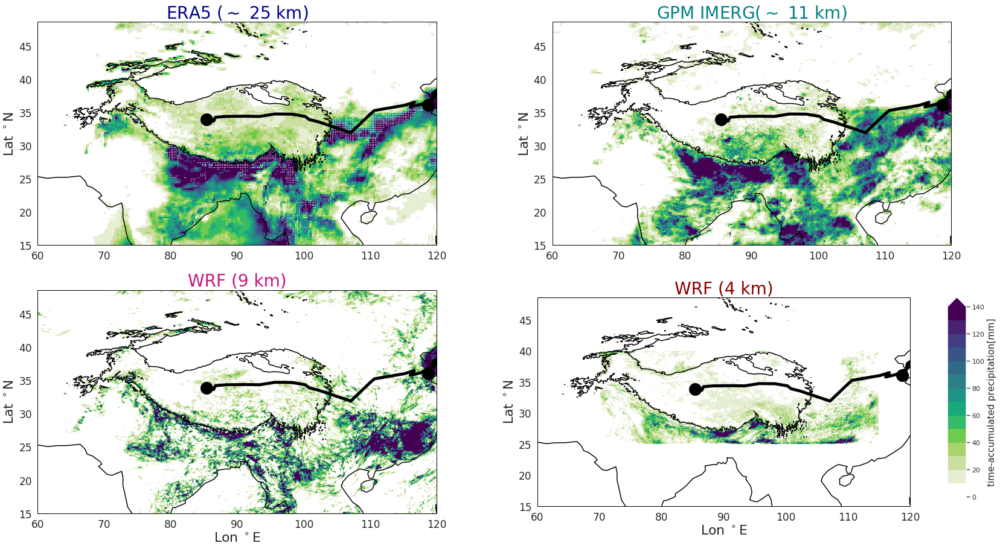

In [250]:
################### plot ######################
plt.figure(figsize= (28,15))

# labels, fontsize, color 
xlabels=[60,70,80,90,100,110,120]
ylabels= [15,20,25,30,35,40,45]
fs= 22
c= 'k'
# customizing of colorbar 
cmap= viridis_white_r
r = np.arange(0, 150, 10)
norm = colors.BoundaryNorm(boundaries= r,  ncolors= 256)

# Plot ERA5 
ax = plt.subplot(2, 2, 1, projection=ccrs.PlateCarree())
ax.set_extent([60,120,15,45])
ax.set_title('ERA5 ($\sim$ 25 km)', fontsize= 28, color = 'darkblue')
ax.coastlines(linewidth = 1.5)
lo,la = np.meshgrid(elevations.lon.values,elevations.lat.values)
m= ax.pcolormesh(era.longitude.values, era.latitude.values, era.values,norm = norm, cmap = cmap)  
ax.contour(elevations.lon.values,elevations.lat.values, elevations.data.T, [3000], cmap = 'Greys_r')
ax.scatter(los,las, color= 'white', s= 0.15, marker = 'x')


# axis labels 
ax.set_xticks(xlabels, xlabels)
ax.set_yticks(ylabels,ylabels)
ax.set_xticklabels(xlabels, fontsize= 17)
ax.set_yticklabels(ylabels, fontsize= 17)
ax.set_ylabel('Lat $^\circ$N',  fontsize=fs)
     
# TPV track 
for key in coords.keys():
    track_lons = coords[key][0]
    track_lats =  coords[key][1]
    track = sgeom.LineString(zip(track_lons, track_lats))
    ax.add_geometries([track], ccrs.PlateCarree(),facecolor='none', edgecolor='black', linewidth= 5.0)

# plot vorticity center of timestep 
ax.plot(lon_t[0][0], lat_t[0][0],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')
ax.plot(lon_t[0][-1], lat_t[0][-1],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')

    
# Plot GPM
ax = plt.subplot(2, 2, 2, projection=ccrs.PlateCarree())
ax.set_extent([60,120,15,45])
ax.set_title('GPM IMERG($\sim$ 11 km)', fontsize= 28, color = 'teal')
ax.coastlines(linewidth = 1.5)
lo,la = np.meshgrid(elevations.lon.values,elevations.lat.values)
m = ax.pcolormesh(gpm.lon.values, gpm.lat.values, gpm.values.T,norm = norm, cmap = cmap)  
ax.contour(elevations.lon.values,elevations.lat.values, elevations.data.T, [3000], cmap = 'Greys_r')

# axis labels 
ax.set_xticks(xlabels, xlabels)
ax.set_yticks(ylabels,ylabels)
ax.set_xticklabels(xlabels, fontsize= 17)
ax.set_yticklabels(ylabels, fontsize= 17)
ax.set_ylabel('Lat $^\circ$N',  fontsize=fs)

# TPV track 
for key in coords.keys():
    track_lons = coords[key][0]
    track_lats =  coords[key][1]
    track = sgeom.LineString(zip(track_lons, track_lats))
    ax.add_geometries([track], ccrs.PlateCarree(),facecolor='none', edgecolor='black', linewidth= 5.0)

# plot vorticity center of timestep 
ax.plot(lon_t[0][0], lat_t[0][0],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')
ax.plot(lon_t[0][-1], lat_t[0][-1],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')



### WRF subplot ###
xlabels=[60,70,80,90,100,110,120]
ylabels= [15,20,25,30,35,40,45]
ax2 = plt.subplot(2, 2, 3, projection=ccrs.PlateCarree())
ax2.set_extent([60,120,15,45])
ax2.set_title('WRF (9 km)', fontsize = 28, color ='mediumvioletred')
ax2.coastlines(linewidth = 1.5)
# Plot wind vectors 
m2= ax2.pcolormesh(lons, lats, wrf.values, norm=norm, cmap = cmap  )  
ax2.contour(elevations.lon.values,elevations.lat.values, elevations.data.T, [3000], cmap = 'Greys_r')

# TPV track 
for key in coords.keys():
    track_lons = coords[key][0]
    track_lats =  coords[key][1]
    track = sgeom.LineString(zip(track_lons, track_lats))
    ax2.add_geometries([track], ccrs.PlateCarree(),facecolor='none', edgecolor='black', linewidth= 5.0)

# plot vorticity center of timestep 
ax2.plot(lon_t[0][0], lat_t[0][0],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')
ax2.plot(lon_t[0][-1], lat_t[0][-1],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')
# axis labels 
ax2.set_xticks(xlabels, xlabels)
ax2.set_xticklabels(xlabels, fontsize= 17)
ax2.set_yticks(ylabels,ylabels)
ax2.set_yticklabels(ylabels, fontsize= 17)
ax2.set_ylabel('Lat $^\circ$N',  fontsize=fs)
ax2.set_xlabel('Lon $^\circ$E',  fontsize=fs)


### WRF4km subplot ###
xlabels=[60,70,80,90,100,110,120]
ylabels= [15,20,25,30,35,40,45]
ax2 = plt.subplot(2, 2, 4, projection=ccrs.PlateCarree())
ax2.set_extent([60,120,15,45])
ax2.set_title('WRF (4 km)', fontsize = 28, color ='darkred')
ax2.coastlines(linewidth = 1.5)
# Plot wind vectors 
m2= ax2.pcolormesh(wrflons, wrflats, wrf4km.values, norm=norm, cmap = cmap  )  
ax2.contour(elevations.lon.values,elevations.lat.values, elevations.data.T, [3000], cmap = 'Greys_r')

# TPV track 
for key in coords.keys():
    track_lons = coords[key][0]
    track_lats =  coords[key][1]
    track = sgeom.LineString(zip(track_lons, track_lats))
    ax2.add_geometries([track], ccrs.PlateCarree(),facecolor='none', edgecolor='black', linewidth= 5.0)

# plot vorticity center of timestep 
ax2.plot(lon_t[0][0], lat_t[0][0],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')
ax2.plot(lon_t[0][-1], lat_t[0][-1],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')
# axis labels 
ax2.set_xticks(xlabels, xlabels)
ax2.set_xticklabels(xlabels, fontsize= 17)
ax2.set_yticks(ylabels,ylabels)
ax2.set_yticklabels(ylabels, fontsize= 17)
ax2.set_ylabel('Lat $^\circ$N',  fontsize=fs)
ax2.set_xlabel('Lon $^\circ$E',  fontsize=fs)
    
    

# colorbar and fontsize 
cbar = make_colorbar(ax2, m2, orientation='vertical')
cbar.set_label('time-accumulated precipitation[mm]', fontsize = 15)    

plt.savefig('tpv_2008_awt/tpv_accumulated_precip_resolutions_p1_convective.png')
plt.show()

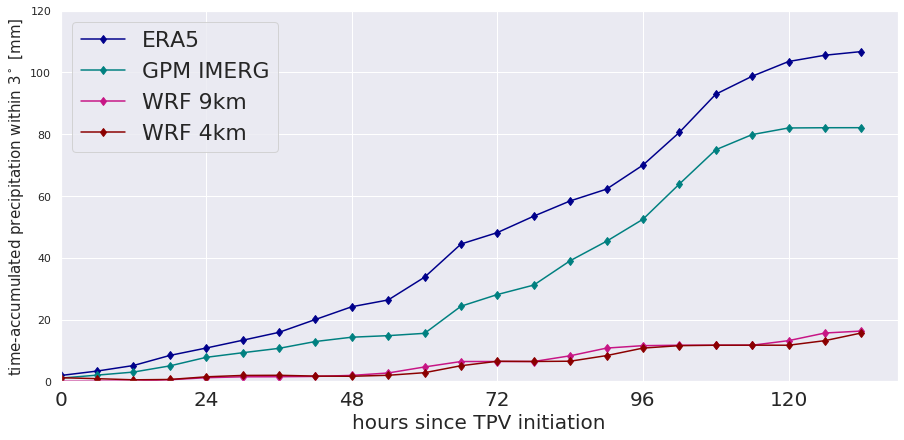

In [118]:
### plot precipitation within radius ###

plt.figure(figsize= (15,15))

ax3 = plt.subplot(2, 1, 1)
sns.set()
ax3.plot(np.arange(len(file_list)), era_precip * 6 , marker = 'd', color = 'darkblue', label = 'ERA5')
ax3.plot(np.arange(len(file_list)), gpm_precip * 6, marker = 'd', color = 'teal', label = 'GPM IMERG')
ax3.plot(np.arange(len(file_list)), wrf_precip * 6, marker = 'd', color = 'mediumvioletred', label = 'WRF 9km')
ax3.plot(np.arange(len(file_list)), wrf4km_precip * 6, marker = 'd', color = 'darkred', label = 'WRF 4km')


ax3.set_xlabel('hours since TPV initiation', fontsize = 20)
ax3.set_ylabel('time-accumulated precipitation within 3$^\circ$ [mm]', fontsize= 15)
ax3.grid('on')
ax3.set_xlim(0,23)
ax3.set_ylim(0, 120)   
ax3.set_xticks(np.arange(23)[::4])
ax3.set_xticklabels(np.arange(23)[::4]*6, fontsize = 20)
ax3.legend(fontsize= 22)

plt.savefig('precipitation_evolution.png')

In [21]:
def plot_precip(file1, file2, times, time_idx):
    ### get precipitation data ### 
    gpm = xr.open_dataset(gpm_files[time_idx])
    gpmprecip = gpm['precipitationCal'][0]
    era = xr.open_dataset(era_files[time_idx])
    eraprecip = era['tp'][0] * 1000 
    wrf = xr.open_dataset(wrf_files[time_idx])
    wrfprecip = wrf['precip_g'][0]
    
    ################### plot ######################
    plt.figure(figsize= (28,15))
    timestr = times[0][time_idx]

    # labels, fontsize, color 
    xlabels=[60,70,80,90,100,110,120]
    ylabels= [15,20,25,30,35,40,45]
    fs= 22
    c= 'k'
    # customizing of colorbar 
    cmap= viridis_white_r
    r = np.arange(0,2 ,0.1)
    norm = colors.BoundaryNorm(boundaries= r,  ncolors= 256)

    # Plot ERA5 
    ax = plt.subplot(2, 2, 1, projection=ccrs.PlateCarree())
    ax.set_extent([60,120,15,45])
    ax.set_title('ERA5', fontsize= 28, color = 'darkblue')
    ax.coastlines(linewidth = 1.5)
    lo,la = np.meshgrid(elevations.lon.values,elevations.lat.values)
    m= ax.pcolormesh(era.longitude.values, era.latitude.values, eraprecip.values,norm = norm, cmap = cmap)  
    ax.contour(elevations.lon.values,elevations.lat.values, elevations.data.T, [3000], cmap = 'Greys_r')

    # axis labels 
    ax.set_xticks(xlabels, xlabels)
    ax.set_yticks(ylabels,ylabels)
    ax.set_xticklabels(xlabels, fontsize= 17)
    ax.set_yticklabels(ylabels, fontsize= 17)
    ax.set_ylabel('Lat $^\circ$N',  fontsize=fs)
     
    # TPV track 
    for key in coords.keys():
        track_lons = coords[key][0]
        track_lats =  coords[key][1]
        track = sgeom.LineString(zip(track_lons, track_lats))
        ax.add_geometries([track], ccrs.PlateCarree(),facecolor='none', edgecolor='black', linewidth= 5.0)

    # plot vorticity center of timestep 
    ax.plot(lon_t[0][0], lat_t[0][0],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')
    ax.plot(lon_t[0][time_idx], lat_t[0][time_idx],transform=ccrs.PlateCarree(), color='crimson', markersize=25,marker= 'o')
    ax.plot(lon_t[0][-1], lat_t[0][-1],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')

    
    # Plot GPM
    ax = plt.subplot(2, 2, 4, projection=ccrs.PlateCarree())
    ax.set_extent([60,120,15,45])
    ax.set_title('GPM', fontsize= 28, color = 'teal')
    ax.coastlines(linewidth = 1.5)
    lo,la = np.meshgrid(elevations.lon.values,elevations.lat.values)
    m = ax.pcolormesh(gpm.lon.values, gpm.lat.values, gpmprecip.values.T,norm = norm, cmap = cmap)  
    ax.contour(elevations.lon.values,elevations.lat.values, elevations.data.T, [3000], cmap = 'Greys_r')

    # axis labels 
    ax.set_xticks(xlabels, xlabels)
    ax.set_yticks(ylabels,ylabels)
    ax.set_xticklabels(xlabels, fontsize= 17)
    ax.set_yticklabels(ylabels, fontsize= 17)
    ax.set_ylabel('Lat $^\circ$N',  fontsize=fs)
     
    # TPV track 
    for key in coords.keys():
        track_lons = coords[key][0]
        track_lats =  coords[key][1]
        track = sgeom.LineString(zip(track_lons, track_lats))
        ax.add_geometries([track], ccrs.PlateCarree(),facecolor='none', edgecolor='black', linewidth= 5.0)

    # plot vorticity center of timestep 
    ax.plot(lon_t[0][0], lat_t[0][0],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')
    ax.plot(lon_t[0][time_idx], lat_t[0][time_idx],transform=ccrs.PlateCarree(), color='crimson', markersize=25,marker= 'o')
    ax.plot(lon_t[0][-1], lat_t[0][-1],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')

    

    ### WRF subplot ###
    xlabels=[60,70,80,90,100,110,120]
    ylabels= [15,20,25,30,35,40,45]
    ax2 = plt.subplot(2, 2, 3, projection=ccrs.PlateCarree())
    ax2.set_extent([60,120,15,45])
    ax2.set_title('WRF 9 km', fontsize = 28, color ='mediumvioletred')
    ax2.coastlines(linewidth = 1.5)
    # Plot wind vectors 
    m2= ax2.pcolormesh(lons, lats, wrfprecip.values, norm=norm, cmap = cmap  )  
    ax2.contour(elevations.lon.values,elevations.lat.values, elevations.data.T, [3000], cmap = 'Greys_r')

    # TPV track 
    for key in coords.keys():
        track_lons = coords[key][0]
        track_lats =  coords[key][1]
        track = sgeom.LineString(zip(track_lons, track_lats))
        ax2.add_geometries([track], ccrs.PlateCarree(),facecolor='none', edgecolor='black', linewidth= 5.0)

    # plot vorticity center of timestep 
    ax2.plot(lon_t[0][0], lat_t[0][0],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')
    ax2.plot(lon_t[0][time_idx], lat_t[0][time_idx],transform=ccrs.PlateCarree(), color='crimson', markersize=25,marker= 'o')
    ax2.plot(lon_t[0][-1], lat_t[0][-1],transform=ccrs.PlateCarree(), color='black', markersize=20,marker= 'o')
    # axis labels 
    ax2.set_xticks(xlabels, xlabels)
    ax2.set_xticklabels(xlabels, fontsize= 17)
    ax2.set_yticks(ylabels,ylabels)
    ax2.set_yticklabels(ylabels, fontsize= 17)
    ax2.set_ylabel('Lat $^\circ$N',  fontsize=fs)
    ax2.set_xlabel('Lon $^\circ$E',  fontsize=fs)
    
    # GPM 
    tpvlon = lon_t[0][time_idx]
    tpvlat = lat_t[0][time_idx]
    gpm_precip[time_idx] = get_precip(tpvlon, tpvlat,'lon','lat', gpmprecip)+ gpm_precip[time_idx-1]
    if time_idx == 0:
        gpm_precip[time_idx] = get_precip(tpvlon, tpvlat,'lon','lat', gpmprecip)

    # ERA5 
    era_precip[time_idx]= get_precip(tpvlon, tpvlat,'longitude','latitude', eraprecip) + era_precip[time_idx-1]
    if time_idx == 0:
        era_precip[time_idx] = get_precip(tpvlon, tpvlat,'longitude','latitude', eraprecip)
    # WRF 9km 
    wrf_precip[time_idx] = get_precip(tpvlon, tpvlat,'lon','lat', wrfprecip, coordinate_flag = False ) + wrf_precip[time_idx-1]
    if time_idx == 0:
        wrf_precip[time_idx] = get_precip(tpvlon, tpvlat,'lon','lat', wrfprecip, coordinate_flag = False)
    
    ### plot precipitation within radius ###
    ax3 = plt.subplot(2, 2, 2)
    sns.set()
    ax3.set_title(timestr)
    ax3.plot(np.arange(len(file_list)), wrf_precip * 6, marker = 'd', color = 'mediumvioletred', label = 'WRF')
    ax3.plot(np.arange(len(file_list)), era_precip * 6 , marker = 'd', color = 'darkblue', label = 'ERA5')
    ax3.plot(np.arange(len(file_list)), gpm_precip * 6, marker = 'd', color = 'teal', label = 'GPM')
    
    ax3.set_xlabel('hour since initiation', fontsize = 20)
    ax3.set_ylabel('accum mean precip within 3$^\circ$ [mm]', fontsize= 20)
    ax3.grid('on')
    ax3.set_xlim(0,23)
    ax3.set_ylim(0, 120)   
    ax3.set_xticks(np.arange(23)[::4])
    ax3.set_xticklabels(np.arange(23)[::4]*6, fontsize = 20)
    ax3.legend(fontsize= 22)

    # colorbar and fontsize 
    cbar = make_colorbar(ax, m, orientation='vertical')
    cbar.set_label('precipitation [mm h$^{-1}$]', fontsize = fs)    
    
    plt.savefig('tpv_2008_awt/tpv_'+ str(timestr)+'_precip.png')
    plt.show()

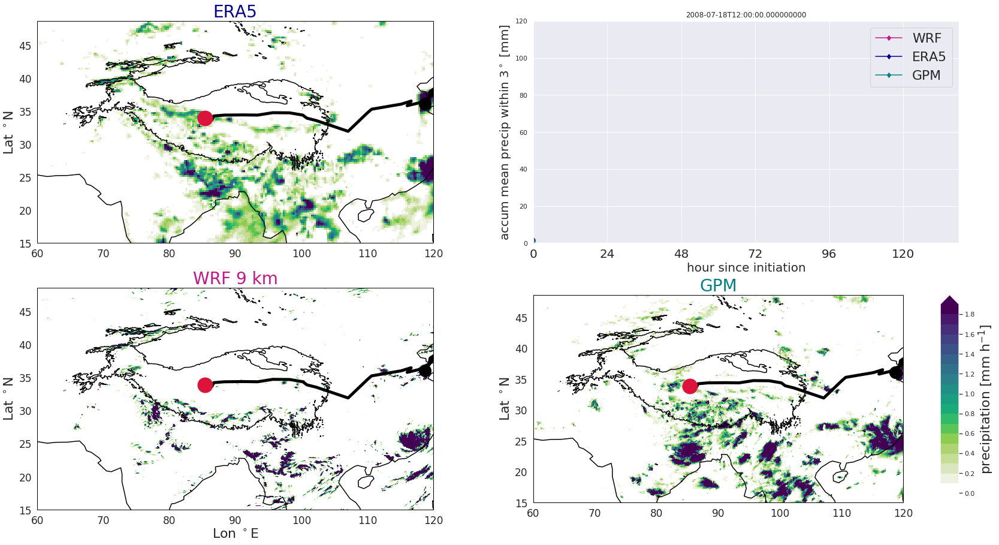

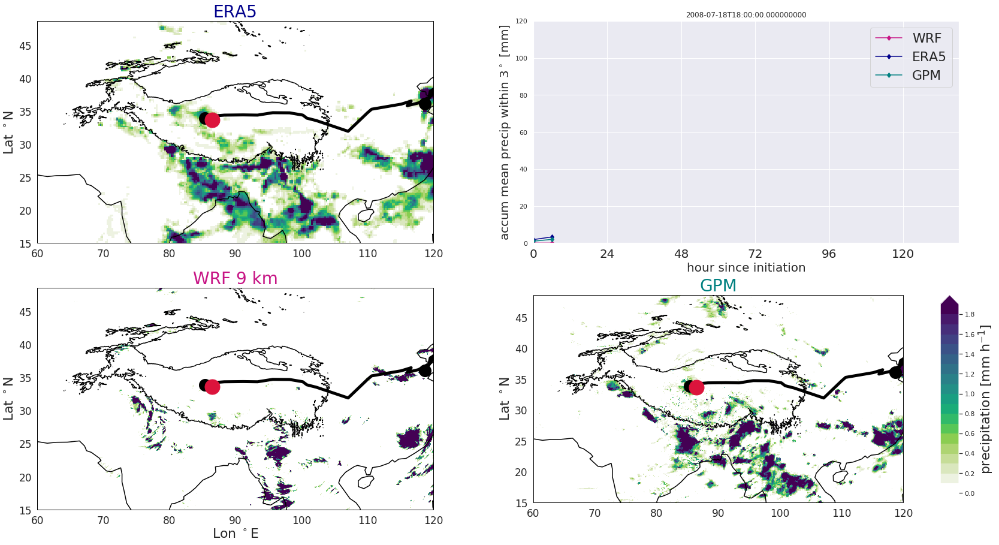

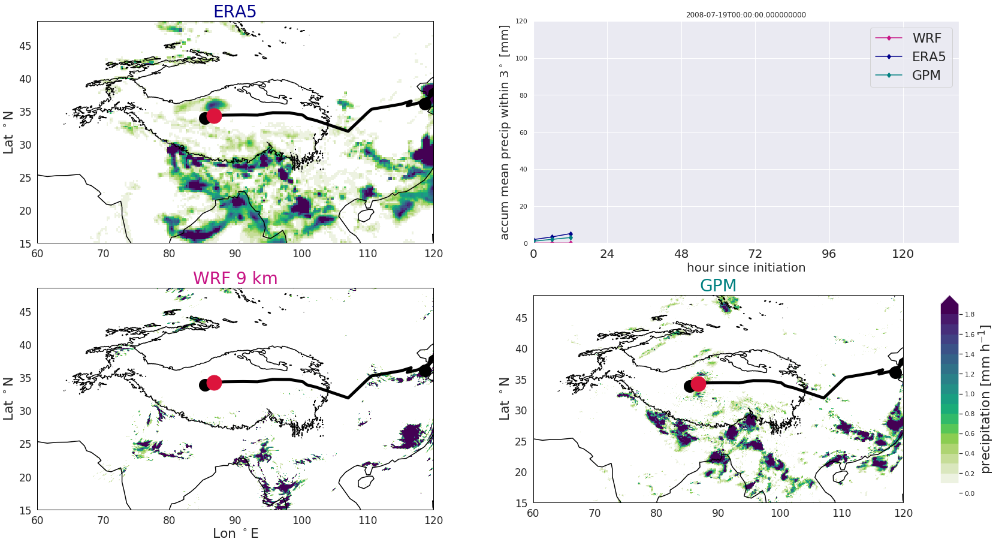

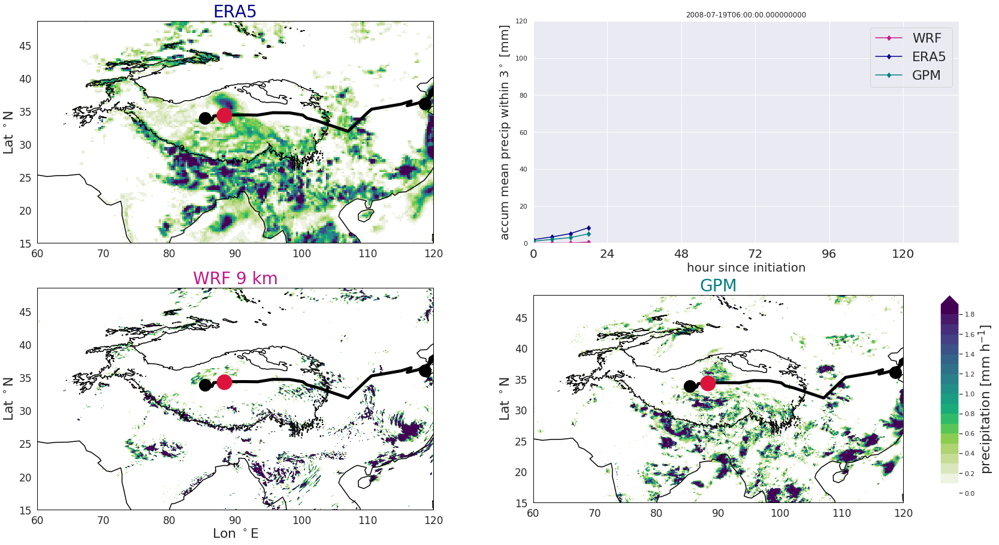

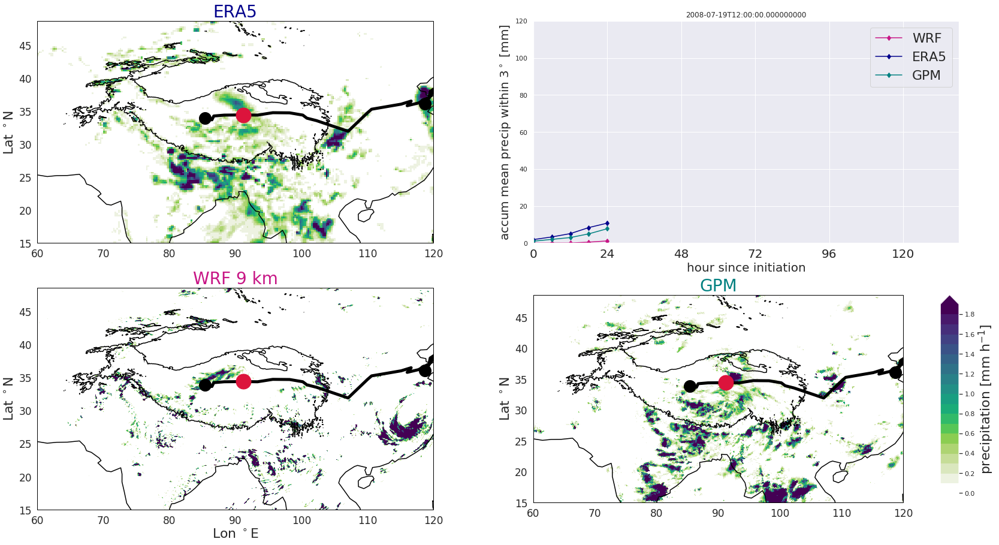

...

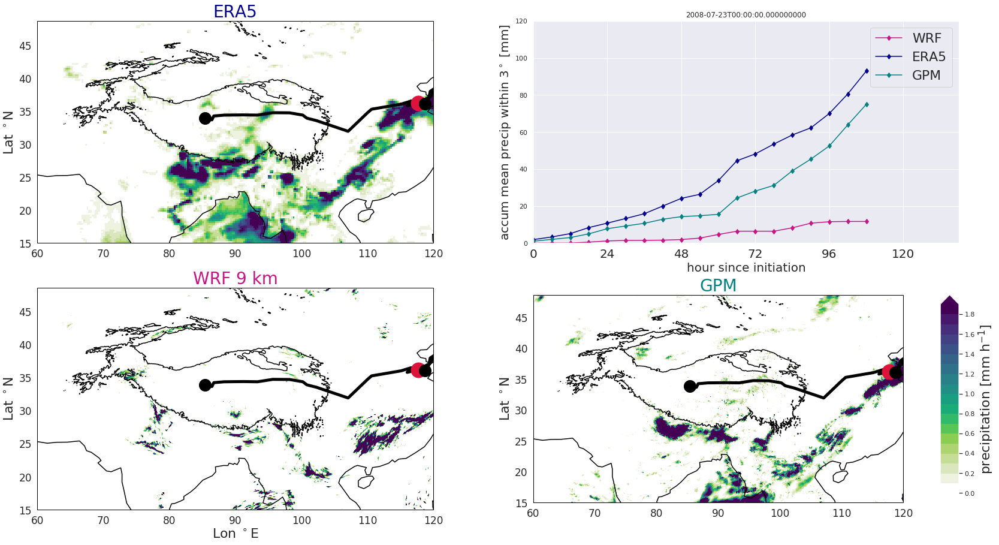

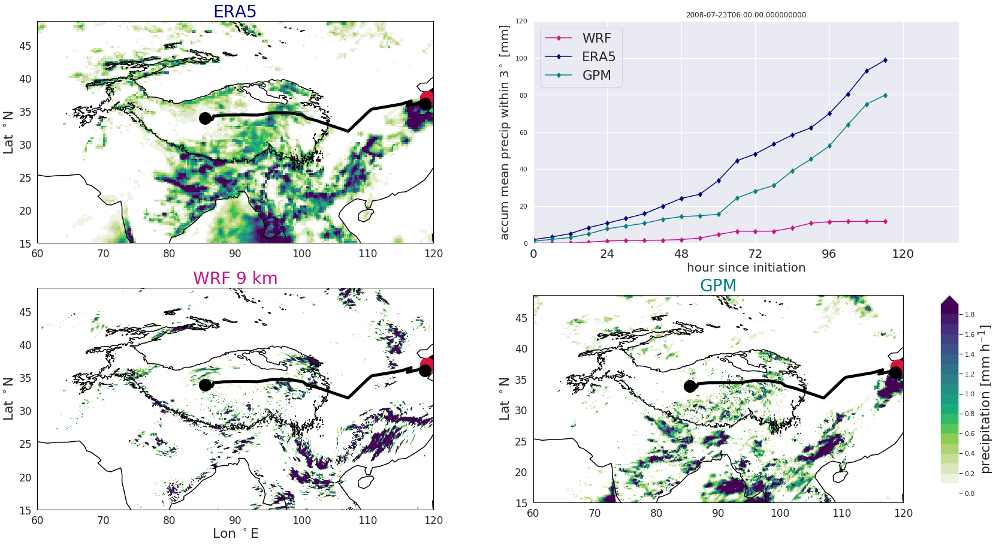

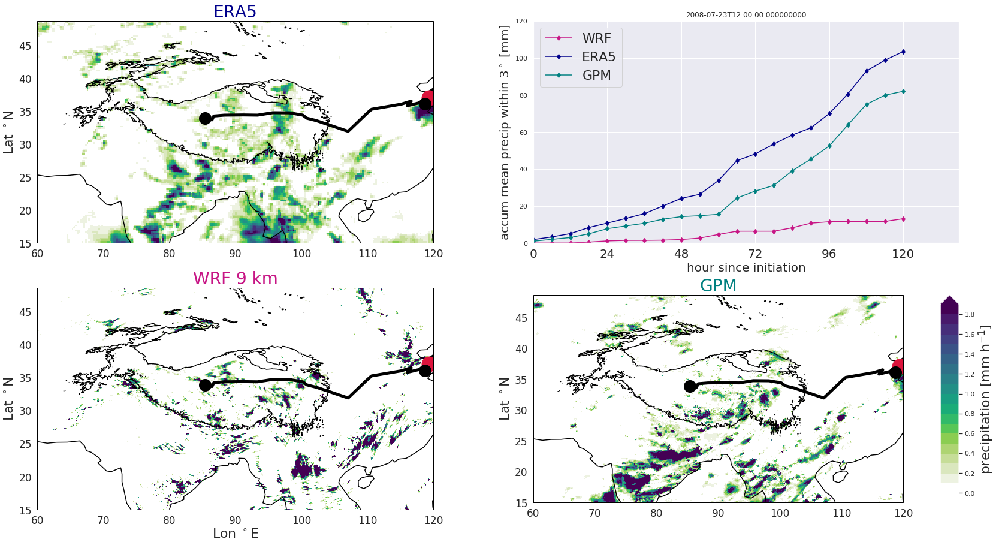

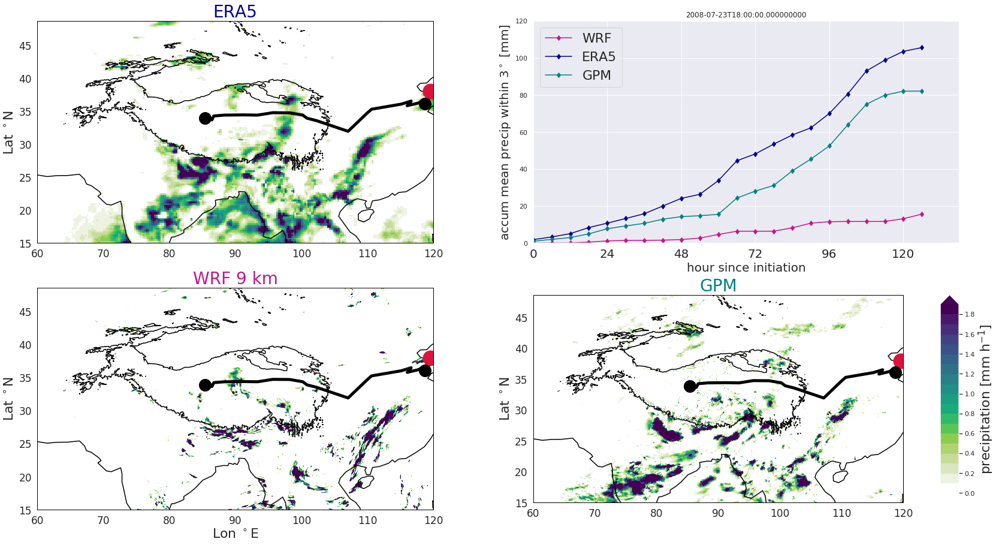

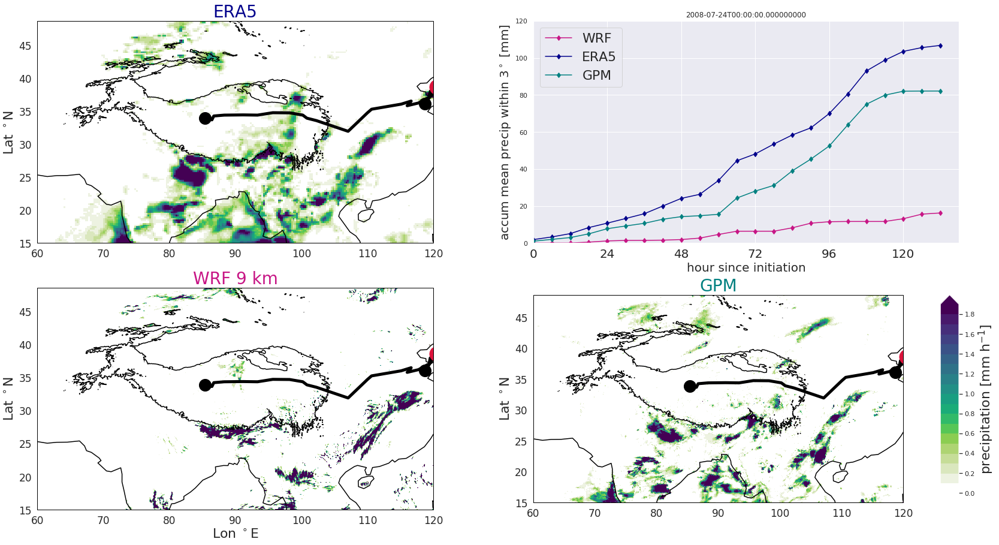

In [32]:
wrf_precip= np.zeros(len(file_list))
wrf_precip[:] = np.nan
era_precip= np.zeros(len(file_list))
era_precip[:] = np.nan
gpm_precip= np.zeros(len(file_list))
gpm_precip[:] = np.nan 


for time_idx in np.arange(23): 
    file1= era_file_list[time_idx]
    file2 = file_list[time_idx]
    plot_precip(file1, file2, times, time_idx)

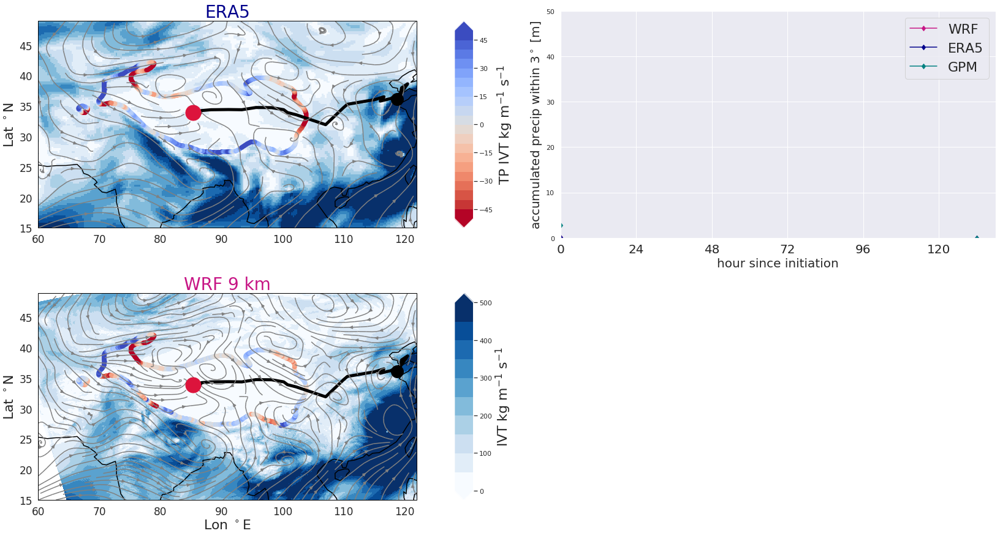

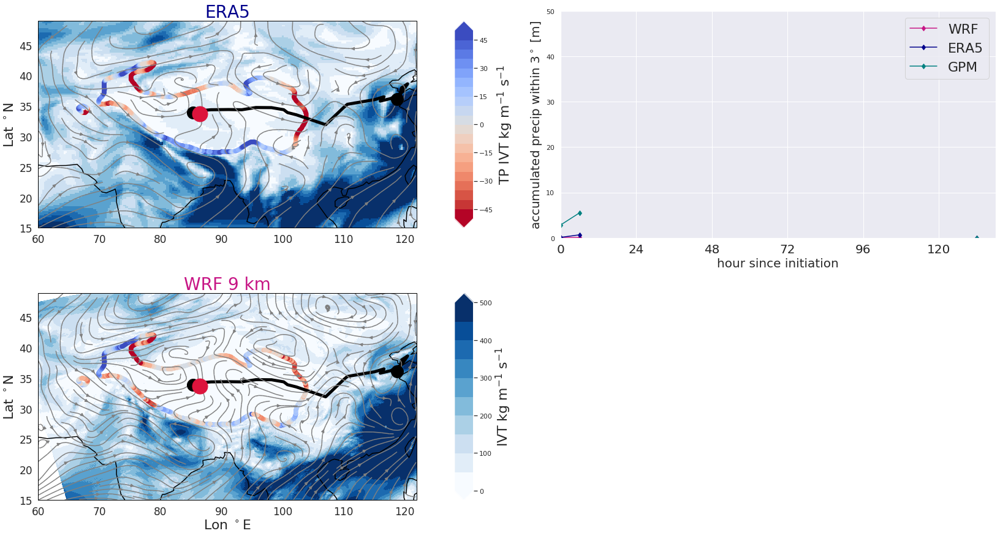

KeyboardInterrupt: 

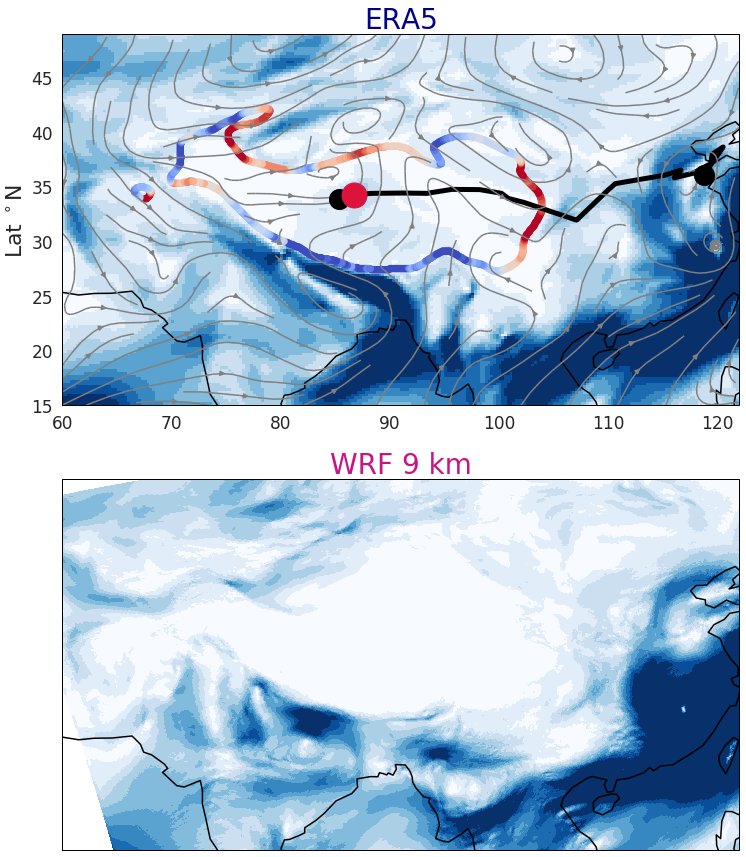

In [179]:
wrf_precip= np.zeros(len(file_list))
era_precip= np.zeros(len(file_list))
gpm_precip= np.zeros(len(file_list))


for time_idx in np.arange(len(file_list)):
    file1= era_file_list[time_idx]
    file2 = file_list[time_idx]
    plot_comparison_precip(file1, file2, times, time_idx)


## Calculate IVT transport towards TPV center 



In [449]:
# needed input data : 
time_idx = 1
# velocity field
dataset = xr.open_dataset(era_file_list[time_idx], decode_times=False)
awt_u= dataset['p71.162'][0]
awt_v= dataset['p72.162'][0]
eralons = dataset.longitude
eralats = dataset.latitude
distances = haversine(tlon, tlat, eralons, eralats)

In [473]:
def get_awt_tpv(time_idx, lons, lats, awt_u, awt_v):
    # TPV centers and distances to center
    tlon = tpv.lon.values[time_idx-0]
    tlat = tpv.lat.values[time_idx-0]
    # get points before and after time point 
    tlon0= tpv.lon.values[time_idx]
    tlat0= tpv.lat.values[time_idx]
    tlon1= tpv.lon.values[time_idx + 1]
    tlat1= tpv.lat.values[time_idx + 1]
    # calculate velocity of TPV in both u and v direction
    seconds= 12*60*60
    tpv_u = haversine(tlon0,tlat0, tlon1, tlat0)*1000 / seconds
    tpv_v= haversine(tlon1,tlat0, tlon1, tlat1)* 1000/  seconds

    ##### gradient field of distances in km (by haversine) #####
    # think about minus sign because now it vector should point in the different direction !

    dlat, dlon  = get_spacing(lats, lons)
    dx= dy_dlon(distances, dlon) 
    dy= dy_dlat(distances, dlat)
    dzdx = np.hstack([dx, np.zeros((lats.size,2))])
    dzdy = np.vstack([dy, np.zeros((2,lons.size))])

    # normalize gradient field (scipy linear algebra norm)
    norm =  -np.sqrt(dzdx**2 + dzdy**2)
    nx= np.divide(dzdx, norm)
    ny = np.divide(dzdy, norm) 

    ####compute velocity of TPV (first derivate of center positions-> u, v)
    #(velocity x gradient is advection, so when inward transport to vortex center is when velocity= wind)
    radius_mask = ((distances < 313.0) & (distances > 286 ))

    # then offset wind field with velocity 
    u = awt_u - tpv_u 
    v= awt_v - tpv_v

    # dot product of n vector and u and v components of water vapor transport -> map with upward water transport
    dotproduct = u * nx + v * ny

    # mask out contour line -> which is in this case the radius around the TPV center 
    dotproduct.values[radius_mask == False]= np.nan
    
    return dotproduct.values


/home/juli/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:26: RuntimeWarning: invalid value encountered in true_divide
/home/juli/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:27: RuntimeWarning: invalid value encountered in true_divide


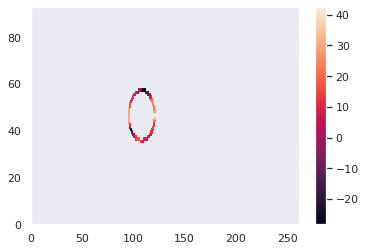

In [474]:
dotproduct = get_awt_tpv(1, eralons,eralats, awt_u, awt_v)
plt.pcolormesh(dotproduct)
plt.colorbar()